In [7]:
import sys
sys.path.append('/home/alexander/Desktop/univer/BrandNewResearch')

from collections import defaultdict

from MyPackage.Models.SelkovStrogatz1D.SelkovStrogatz1DConfiguration import SelkovStrogatz1DConfiguration
from MyPackage.Models.SelkovStrogatz1D.SelkovStrogatz1DTdmaSolver import integrate_tdma_implicit_scheme, TdmaParameters1D
from MyPackage.MathHelpers.InitDataHelpers import *

from MyPackage.Drawing.DrawTransient1D import draw_transient
from MyPackage.Drawing.DrawHelper import set_defaults_1D
from MyPackage.ResearchHelpers.UsefulNotebookDrawings import draw_quadreega
from MyPackage.DataAnalyzers.PeaksAnalyzer import calc_presence
from MyPackage.DataAnalyzers.CheckResultsHelper import check_robustness
from MyPackage.DataContainers.Experiment import Experiment
from MyPackage.DataContainers.ExperimentHelper import read_experiments_from_dir

from MyPackage.DataAnalyzers.PeaksAnalyzer import calc_peaks_by_Fourier, calc_multiple_Fourier_coeffs


import pylab as plt
import numpy as np
import seaborn as sns
from tqdm import tqdm
from sklearn import preprocessing
import random

random.seed(228)


%load_ext autoreload

%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [8]:
set_defaults_1D()
FOURIER_KS = np.array([round(x / 2, 1) for x in range(1,21)])

In [9]:
exps_big_range = read_experiments_from_dir('/media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5')

Processing /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/9000_10009: : 88000it [27:58, 52.44it/s] 


In [10]:
len(exps_big_range)

88000

In [11]:
params_to_exps = defaultdict(list)
for e in exps_big_range:
    conf = e.model_config
    params_to_exps[(conf['a'], conf['b'])].append(e)

In [12]:
for k, v in params_to_exps.items():
    assert len(v) == 500, str(k)

In [13]:
a_index = {y:i for i,y in enumerate(sorted(set(x[0] for x in params_to_exps)))}
b_index = {y:i for i,y in enumerate(sorted(set(x[1] for x in params_to_exps)))}

 a in [0.0025, 0.1275], b in [0.6, 1.35]


/tmp/ipykernel_14952/3236916021.py:12: RuntimeWarning: invalid value encountered in sqrt
  if 2* b**2 >= (-2*a) + 1 - np.sqrt(1-8*a):
/tmp/ipykernel_14952/3236916021.py:15: RuntimeWarning: invalid value encountered in sqrt
  if 2* b**2 >= (-2*a) + 1 + np.sqrt(1-8*a):


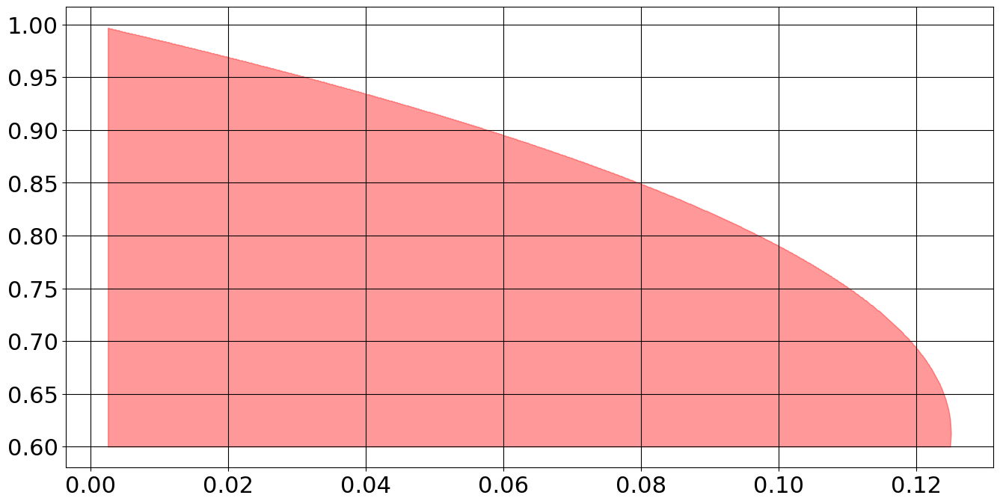

In [14]:
aa = np.linspace(min(a_index), max(a_index), 1001)
bb = np.linspace(min(b_index), max(b_index), 1001)
min_a, max_a, min_b, max_b = min(aa), max(aa), min(bb), max(bb)
print(f" a in [{min_a}, {max_a}], b in [{min_b}, {max_b}]")
hopf_mins = []
hopf_maxs = []
hopf_xs = []
for a in aa:
    min_b = None
    max_b = None
    for b in bb:
        if 2* b**2 >= (-2*a) + 1 - np.sqrt(1-8*a):
            if min_b is None:
                min_b = b
        if 2* b**2 >= (-2*a) + 1 + np.sqrt(1-8*a):
            if max_b is None and min_b is not None:
                max_b = b
    if min_b is None or max_b is None or np.isnan(min_b) or np.isnan(max_b):
        continue
    hopf_xs.append(a)
    hopf_mins.append(min_b)
    hopf_maxs.append(max_b)
hopf_mins = np.array(hopf_mins)
hopf_maxs = np.array(hopf_maxs)
hopf_xs = np.array(hopf_xs)
plt.fill_between(hopf_xs, hopf_mins, hopf_maxs, color='r', label = 'hopf', alpha=.4)

 a in [0.0025, 0.1275], b in [0.6, 1.35]


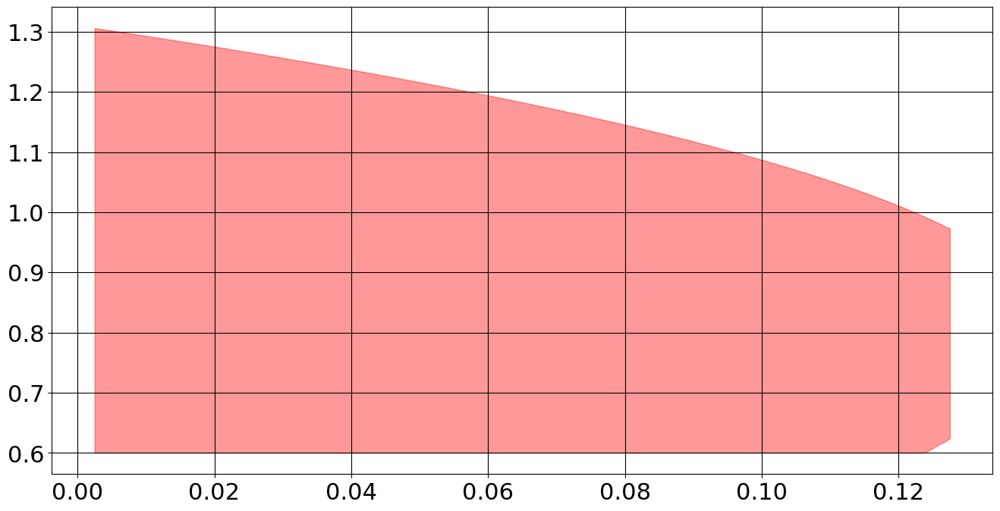

In [15]:
d = 10
aa = np.linspace(min(a_index), max(a_index), 1001)
bb = np.linspace(min(b_index), max(b_index), 1001)

min_a, max_a, min_b, max_b = min(aa), max(aa), min(bb), max(bb)
print(f" a in [{min_a}, {max_a}], b in [{min_b}, {max_b}]")
turing_mins = []
turing_maxs = []
turing_xs = []
for a in aa:
    min_b = None
    max_b = None
    for b in bb:
        if d*(b**2-a) > (b**2 + a)**2 and (d*(b**2-a) - (b**2 + a)**2)**2 > 4*d*(b**2+a)**3:
            if min_b is None:
                min_b = b
        if d*(b**2-a) < (b**2 + a)**2 or (d*(b**2-a) - (b**2 + a)**2)**2 < 4*d*(b**2+a)**3:
            if max_b is None and min_b is not None:
                max_b = b
    if min_b is None or max_b is None or np.isnan(min_b) or np.isnan(max_b):
        continue
    turing_xs.append(a)
    turing_mins.append(min_b)
    turing_maxs.append(max_b)
turing_mins = np.array(turing_mins)
turing_maxs = np.array(turing_maxs)
turing_xs = np.array(turing_xs)
plt.fill_between(turing_xs, turing_mins, turing_maxs, color='r', label = 'turing', alpha=.4)

dict_keys([3.0, 3.5, 1.0, 2.0])


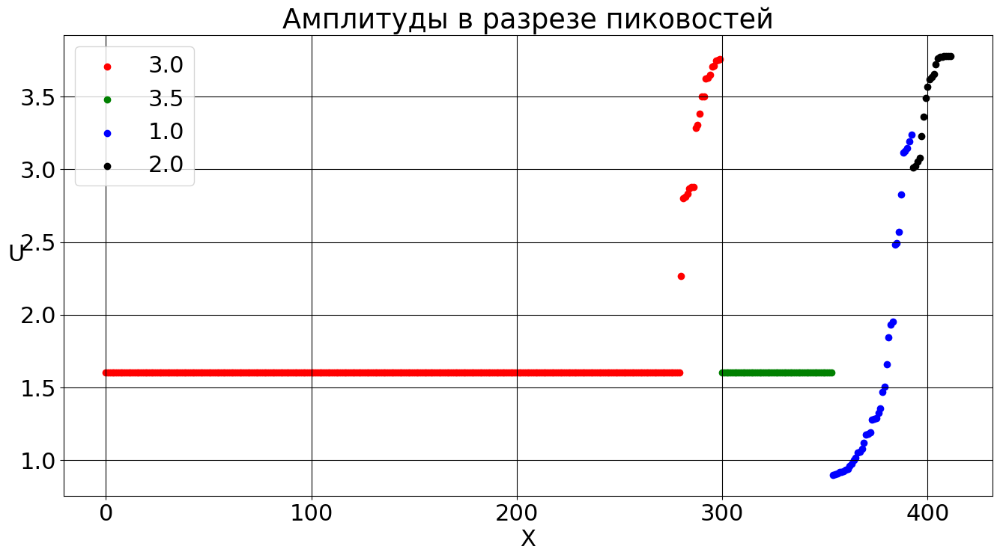

In [16]:
res = defaultdict(list)
res_exps = defaultdict(list)
for exp in params_to_exps[(0.0025, 0.6)]:
    pcks = calc_peaks_by_Fourier(exp,var='u', max_peaks_count=10, min_amplitude=0.1)
    if pcks is None:
        continue
    pcks = pcks.peaks_count
    res[pcks].append(max(exp.end_values['u']) - min(exp.end_values['u']))
    res_exps[pcks].append(exp)
for k in res_exps:
    res_exps[k] = sorted(res_exps[k], key=lambda e: max(e.end_values['u']) - min(e.end_values['u']))
print(res.keys())
ax = plt.gca()
c = ['r','g','b','k']
summ = 0
for i, (k, v) in enumerate(res.items()):

    ax.scatter(range(summ, summ+len(v)), sorted(v), c=c[i], label=f'{k}')
    summ+=len(v)
ax.set_xlabel('X')
ax.set_ylabel('U', rotation=0)
ax.set_title('Амплитуды в разрезе пиковостей')
plt.legend()
plt.show()

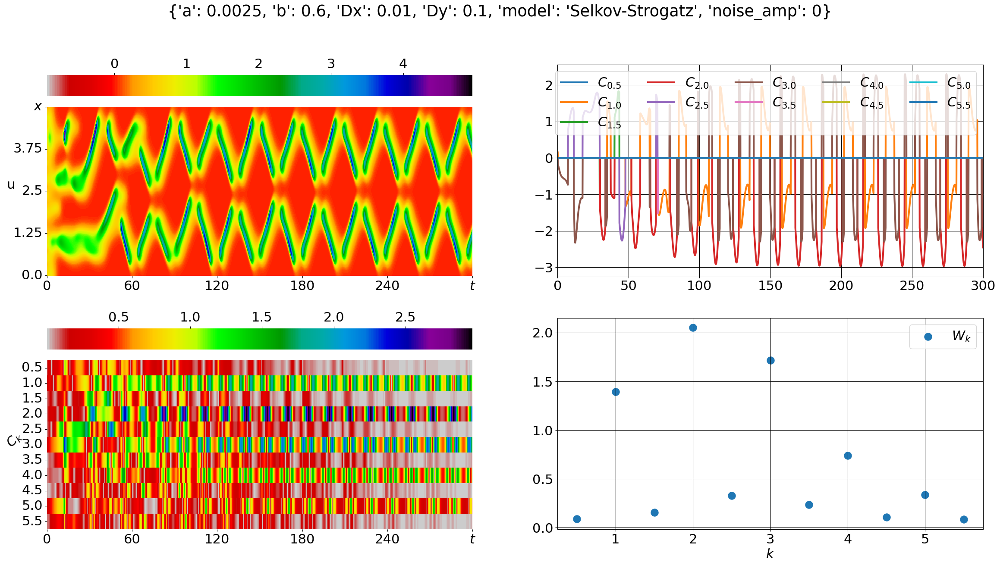

In [11]:
exxx = Experiment().fill_from(res_exps[2.0][0].path_to_file, load_timelines=True)
draw_quadreega(exxx, FOURIER_KS[:11], 'u', right_border_t=300)

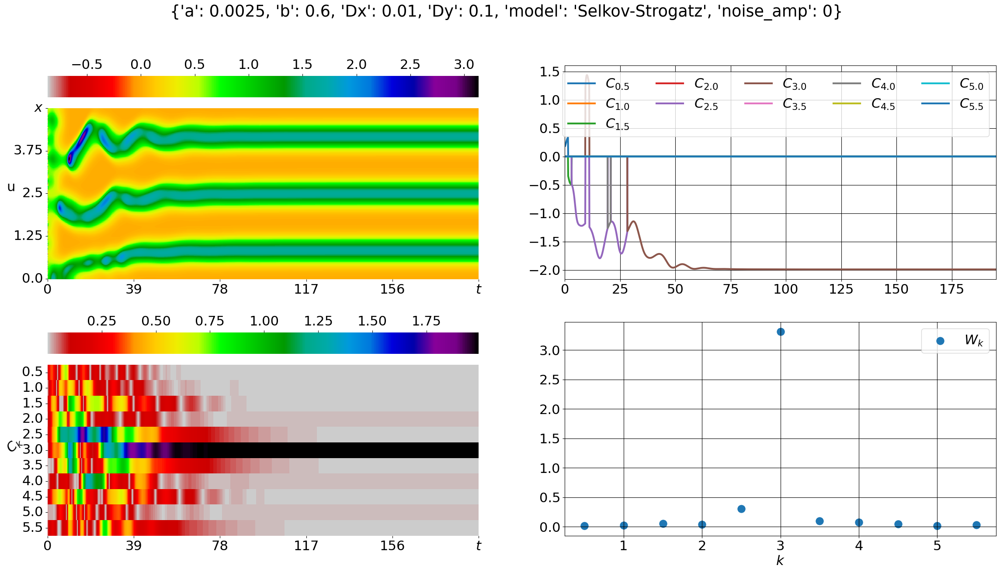

In [12]:
exxx1 = Experiment().fill_from(res_exps[3.0][50].path_to_file, load_timelines=True)
draw_quadreega(exxx1, FOURIER_KS[:11], 'u', right_border_t=300)

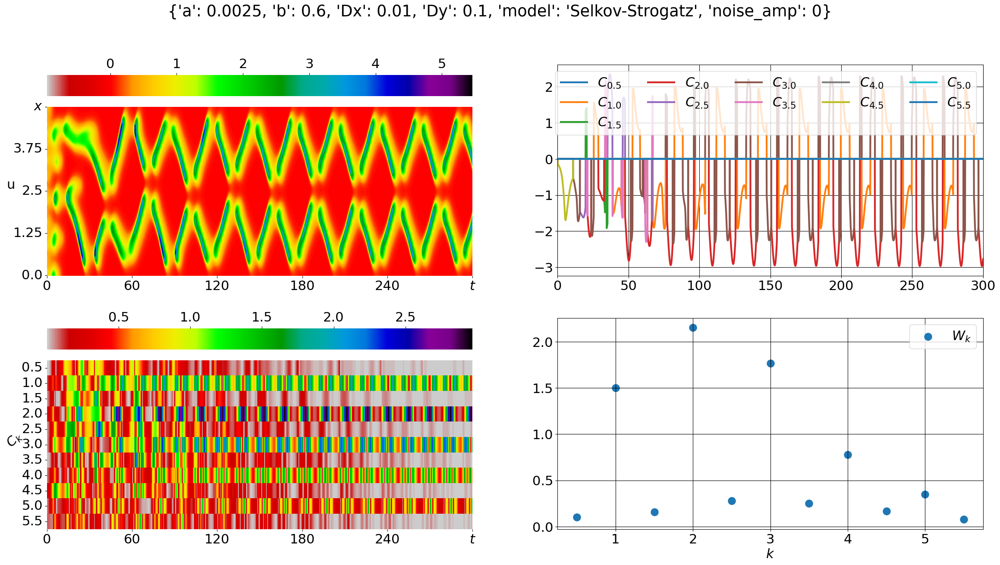

In [15]:
exxx2 = Experiment().fill_from(res_exps[2.0][10].path_to_file, load_timelines=True)
draw_quadreega(exxx2, FOURIER_KS[:11], 'u', right_border_t=300)

In [17]:
def draw_and_get(ex, label):
    cfs = calc_multiple_Fourier_coeffs(ex.end_values['u'], ex.method_parameters['dx'], FOURIER_KS)
    plt.plot(cfs.keys(), cfs.values(), label=label)
    return np.array(list(cfs.values()))



cfs = draw_and_get(exxx, 'shit')
cfs1 = draw_and_get(exxx1, 'good')
cfs2 = draw_and_get(exxx2, 'shit')
plt.legend()
plt.show()

plt.plot(cfs, label='shit')
plt.plot(cfs1, label='good')
plt.plot(cfs2, label='shit')
plt.legend()
plt.show()

sns.swarmplot(cfs, label='shit')
sns.swarmplot(cfs1, label='good')
sns.swarmplot(cfs2, label='shit')
plt.legend()

print((cfs).std(),(cfs1).std(),(cfs2).std())
print(np.abs(preprocessing.normalize(cfs[:,np.newaxis], axis=0)).max(),
      np.abs(preprocessing.normalize(cfs1[:,np.newaxis], axis=0)).max(),
      np.abs(preprocessing.normalize(cfs2[:,np.newaxis], axis=0)).max())

plt.plot(preprocessing.normalize(cfs[:,np.newaxis], axis=0), label='shit')
plt.plot(preprocessing.normalize(cfs1[:,np.newaxis], axis=0), label='good')
plt.plot(preprocessing.normalize(cfs2[:,np.newaxis], axis=0), label='shit')
plt.legend()
plt.show()

NameError: name 'exxx' is not defined

In [18]:
waves = []
no_waves = []
points = []
points_norm = []
for e in tqdm(exps_big_range):
    cfs = calc_multiple_Fourier_coeffs(e.end_values['u'], e.method_parameters['dx'], FOURIER_KS).values()
    points.append(np.std(list(cfs)))
    points_norm.append(np.std(preprocessing.normalize(np.array(list(cfs))[np.newaxis, :])))
    arr = waves if np.std(list(cfs)) >= .52 else no_waves
    arr.append(e)

100%|██████████| 88000/88000 [00:17<00:00, 5144.66it/s]


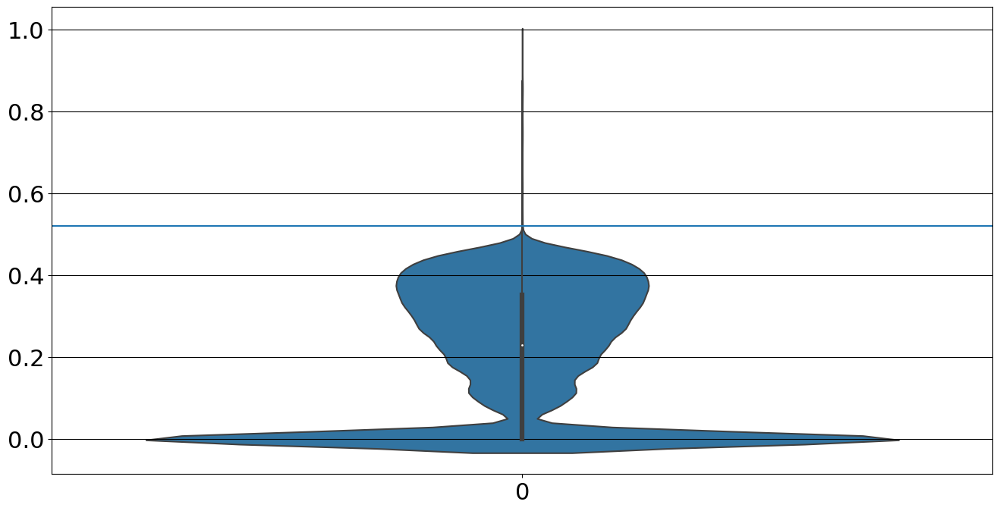

In [15]:
sns.violinplot(points)
plt.gca().axhline(.52)
plt.show()

In [19]:
len(waves), len(no_waves)

(96, 87904)

25it [01:28,  3.52s/it]


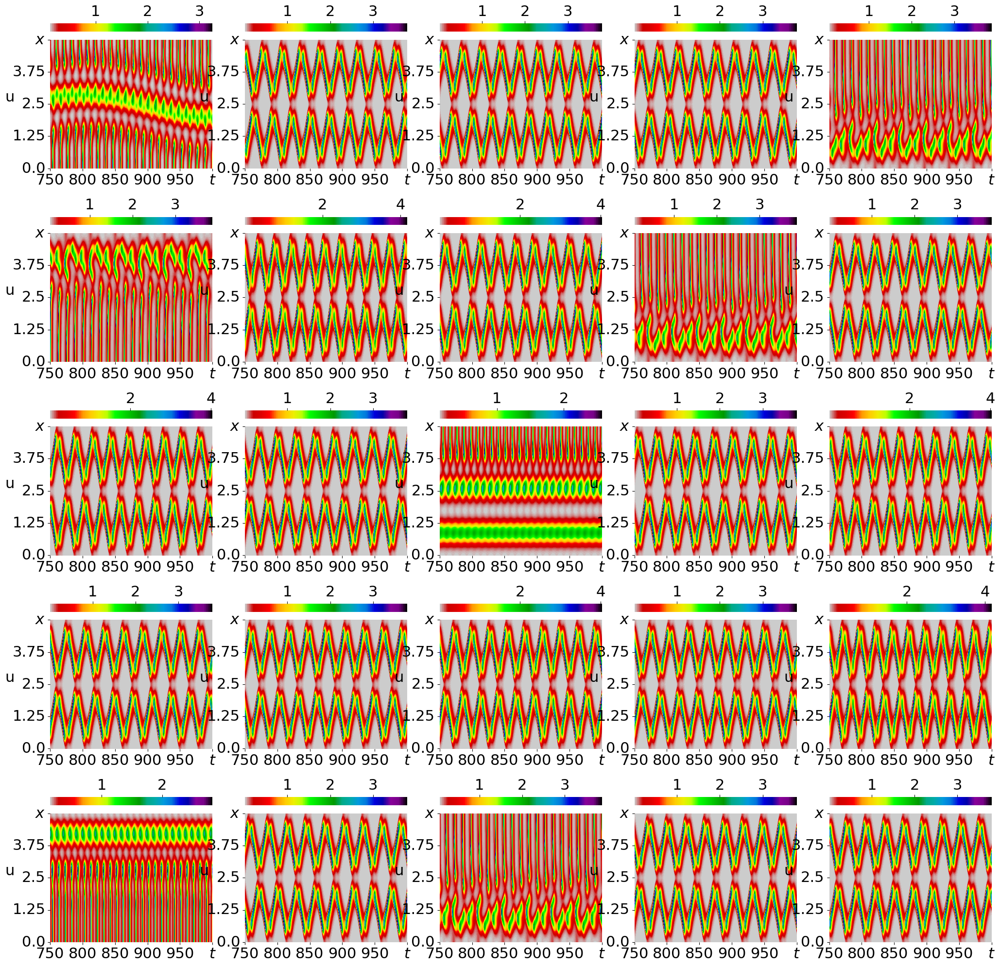

In [28]:
fig, axes = plt.subplots(5,5,figsize=(25,25))

for ax, e in tqdm(zip(axes.flatten(), random.sample(waves, 25))):
    cur_e = Experiment().fill_from(e.path_to_file, load_timelines=True)
    end = cur_e.timelines['u'].shape[0] * cur_e.method_parameters['dt'] * cur_e.method_parameters['timeline_save_step_delta']
    draw_transient(cur_e, left_border=max(0, end - 250), right_border=end,ax=ax)
plt.show()

49it [04:16,  5.23s/it]


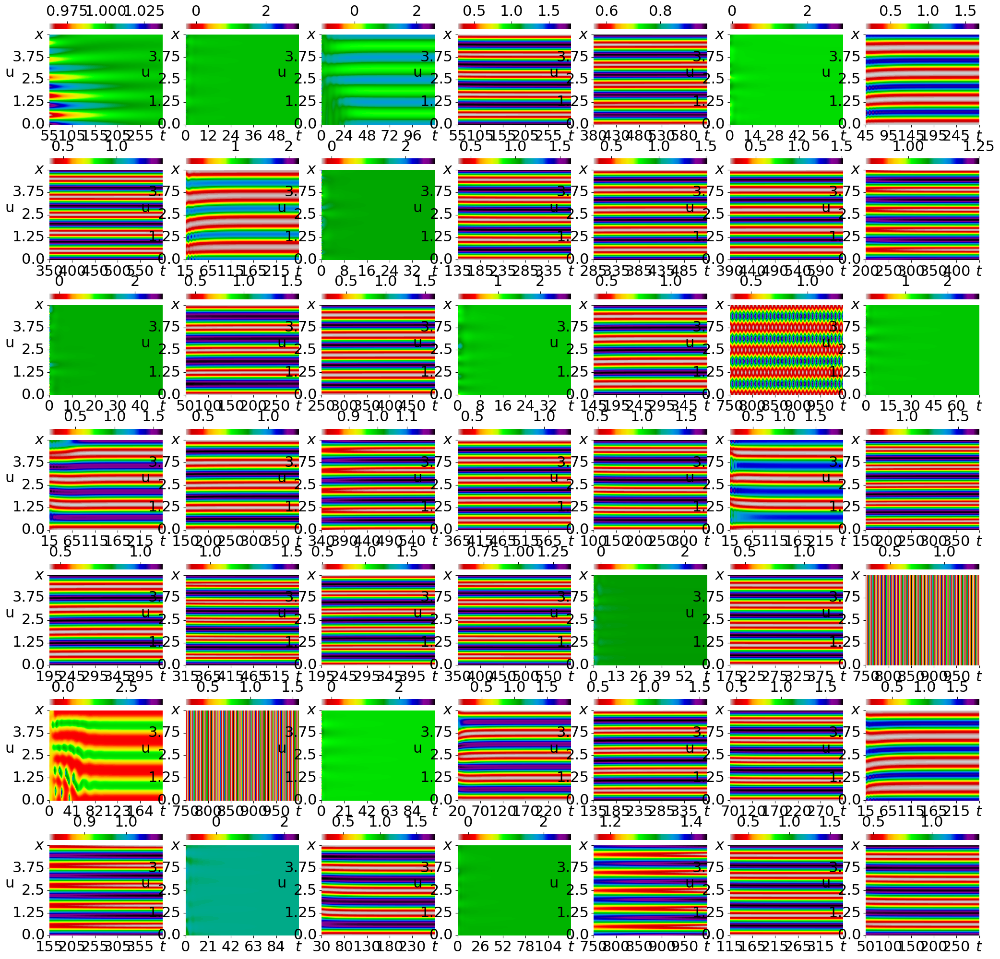

In [30]:
fig, axes = plt.subplots(7,7,figsize=(25,25))

for ax, e in tqdm(zip(axes.flatten(), random.sample(no_waves, 49))):
    cur_e = Experiment().fill_from(e.path_to_file, load_timelines=True)
    end = cur_e.timelines['u'].shape[0] * cur_e.method_parameters['dt'] * cur_e.method_parameters['timeline_save_step_delta']
    draw_transient(cur_e, left_border=max(0, end - 250), right_border=end,ax=ax)
plt.show()

In [98]:
def get_and_draw_stats(exps, draw = False):
    stat_patt = defaultdict(int)
    count_patt = 0
    stat_amp = defaultdict(list)
    skipped = 0
    if draw:
        ax = plt.gca()
    for e in exps:
        cfs = calc_multiple_Fourier_coeffs(e.end_values['u'], e.method_parameters['dx'], FOURIER_KS).values()
        
        pcks = calc_peaks_by_Fourier(e,var='u', max_peaks_count=10, min_amplitude=0.15)
        if pcks is None:
            continue
        if np.std(list(cfs)) >= .52:
            skipped += 1
            continue
        if draw:
            ax.plot(e.end_values['u'])
        stat_patt[(pcks.peaks_count, str(pcks.direction))]+=1
        count_patt+=1
        stat_amp[(pcks.peaks_count, str(pcks.direction))].append(max(e.end_values['u']) - min(e.end_values['u']))
    if draw:
        plt.show()
    stat_patt = {k:stat_patt[k] for k in sorted(stat_patt)}

    amp_mean_max = 0 if not stat_amp else min(sum(x)/len(x) for x in stat_amp.values())
    amp_max_delta = 0 if not stat_amp else max(max(x) - min(x) for x in stat_amp.values())
    amp_mean = np.mean([np.mean(x) for x in stat_amp.values()])
    return count_patt, stat_patt, amp_mean_max, amp_max_delta, amp_mean, skipped


In [99]:
patterns_count = np.zeros((len(a_index), len(b_index)))
pattern_types_count = np.zeros((len(a_index), len(b_index)))
patterns_amp_max = np.zeros((len(a_index), len(b_index)))
patterns_amp_delta = np.zeros((len(a_index), len(b_index)))
patterns_amp_mean = np.zeros((len(a_index), len(b_index)))
waves_count = np.zeros((len(a_index), len(b_index)))
aaa = set()
for key, value in tqdm(params_to_exps.items()):
    count, stat, amp_mean_max, amp_var, amp_mean, skipped = get_and_draw_stats(value)
    #print(stat.keys())
    for a in stat.keys():
        aaa.add(a[0])
    a, b = key
    patterns_count[a_index[a], b_index[b]] += count
    pattern_types_count[a_index[a], b_index[b]] = len(stat)
    patterns_amp_max[a_index[a], b_index[b]] = amp_mean_max
    patterns_amp_delta[a_index[a], b_index[b]] = amp_var
    patterns_amp_mean[a_index[a], b_index[b]] = amp_mean
    waves_count[a_index[a], b_index[b]] = skipped



  7%|▋         | 12/177 [00:02<00:29,  5.52it/s]/home/alexander/miniconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/alexander/miniconda3/lib/python3.9/site-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
 99%|█████████▉| 176/177 [00:25<00:00,  6.81it/s]


TypeError: cannot unpack non-iterable float object

{'a': 0.0275, 'b': 1.0, 'Dx': 0.01, 'Dy': 0.1, 'model': 'Selkov-Strogatz'}
{'a': 0.0275, 'b': 1.0, 'Dx': 0.01, 'Dy': 0.1, 'model': 'Selkov-Strogatz'}


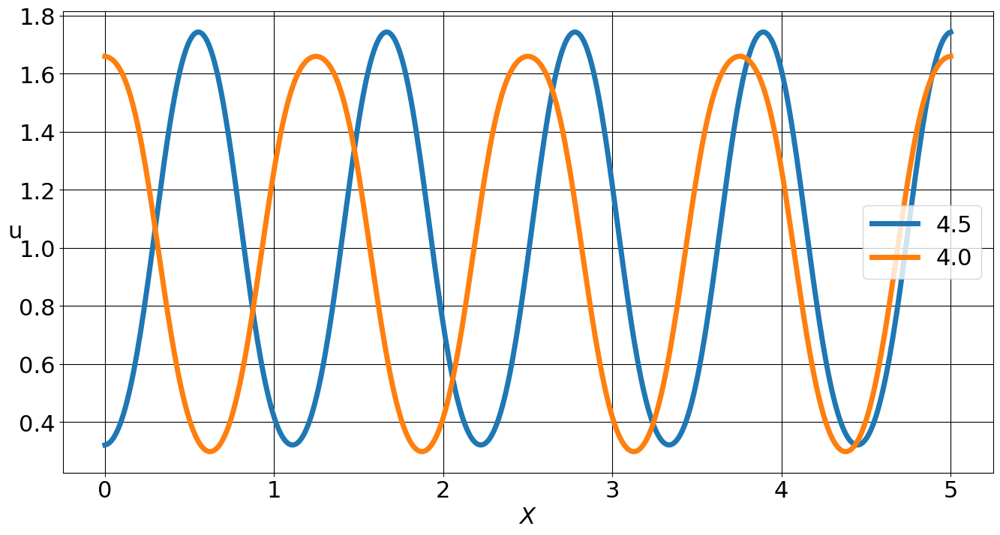

In [90]:
from MyPackage.Drawing.DrawPattern1D import draw_pattern
plotted = set()
for exp in params_to_exps[(0.0275, 1.0)]:
    pcks = calc_peaks_by_Fourier(exp, 'u', 10)
    if str(pcks.direction) == 'PatternDirection.UP' and int(pcks.peaks_count) == 4:
        if pcks.peaks_count in plotted:
            continue
        plotted.add(pcks.peaks_count)
        print(exp.model_config)
        draw_pattern(exp, 'u', label=pcks.peaks_count)
plt.legend()

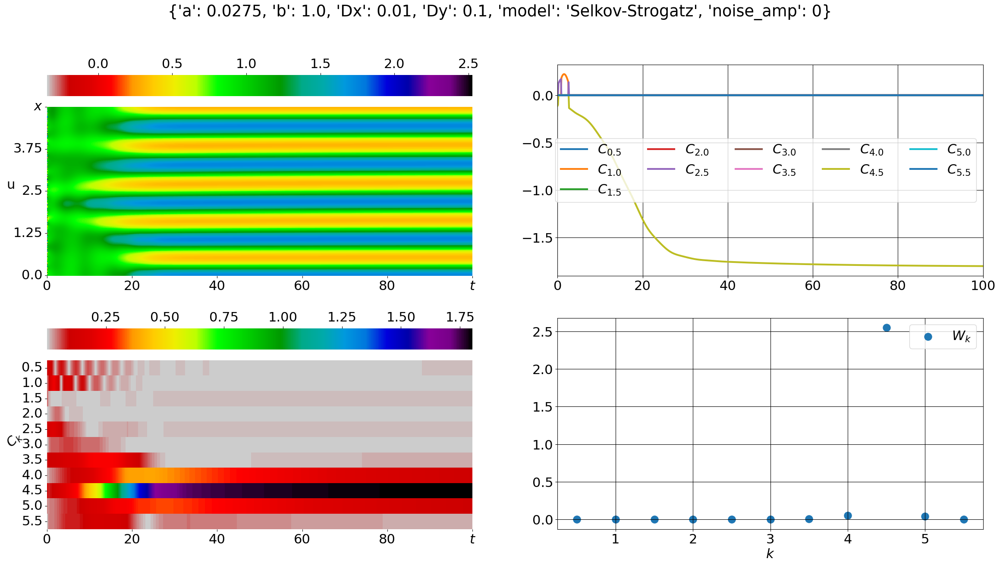

In [86]:
draw_quadreega(Experiment().fill_from(exp.path_to_file, load_timelines=True), var_name='u', ks=FOURIER_KS[:11], right_border_t=100)

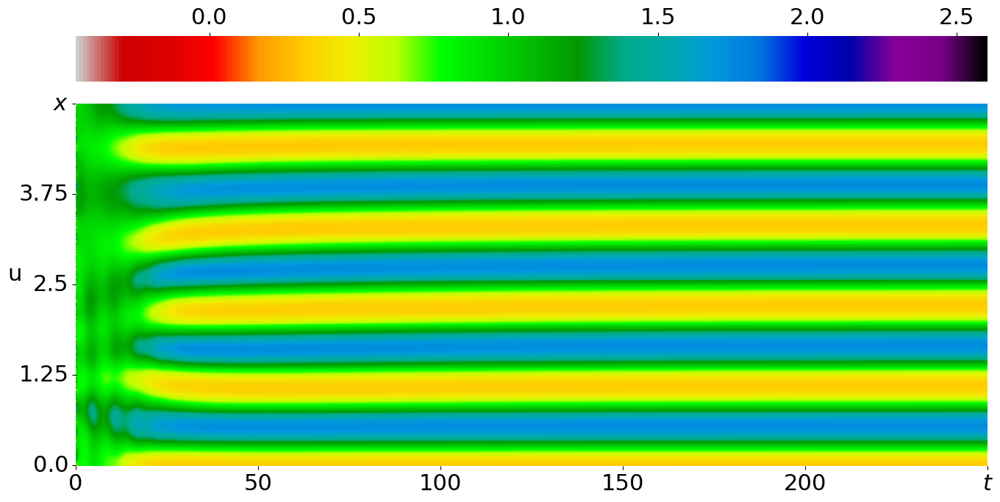

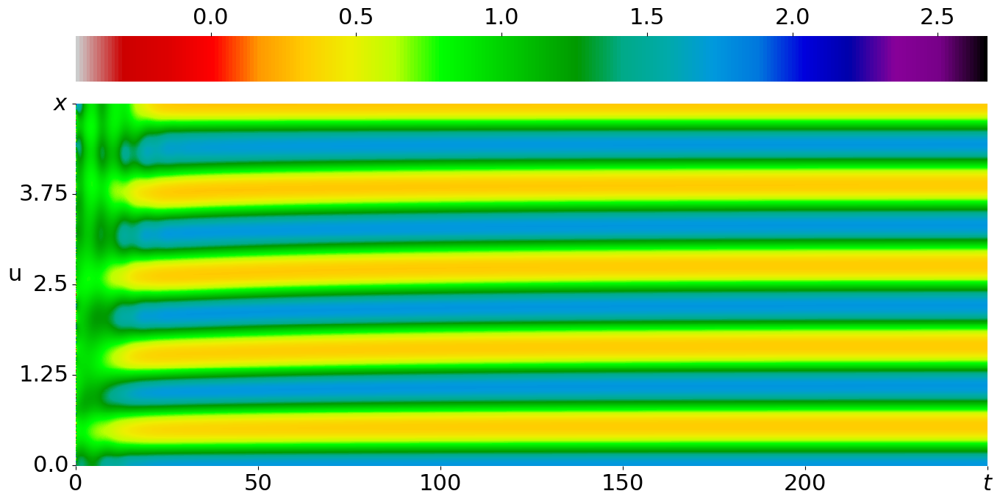

({'a': 0.0275, 'b': 1.0, 'Dx': 0.01, 'Dy': 0.1, 'model': 'Selkov-Strogatz'},
 {'a': 0.0275, 'b': 1.0, 'Dx': 0.01, 'Dy': 0.1, 'model': 'Selkov-Strogatz'})

In [47]:

draw_transient(ex2:=Experiment().fill_from(params_to_exps[(0.0275, 1.0)][1].path_to_file, load_timelines=True), right_border=250)
plt.show()
draw_transient(ex3:=Experiment().fill_from(params_to_exps[(0.0275, 1.0)][2].path_to_file, load_timelines=True),

In [ ]:
 right_border=250)
plt.show()
ex2.model_config, ex3.model_config

[ 0.5  1.5  2.5  3.5  4.5  5.5  6.5  7.5  8.5  9.5 10.5]
[ 0.5  1.5  2.5  3.5  4.5  5.5  6.5  7.5  8.5  9.5 10.5 11.5 12.5 13.5
 14.5 15.5]


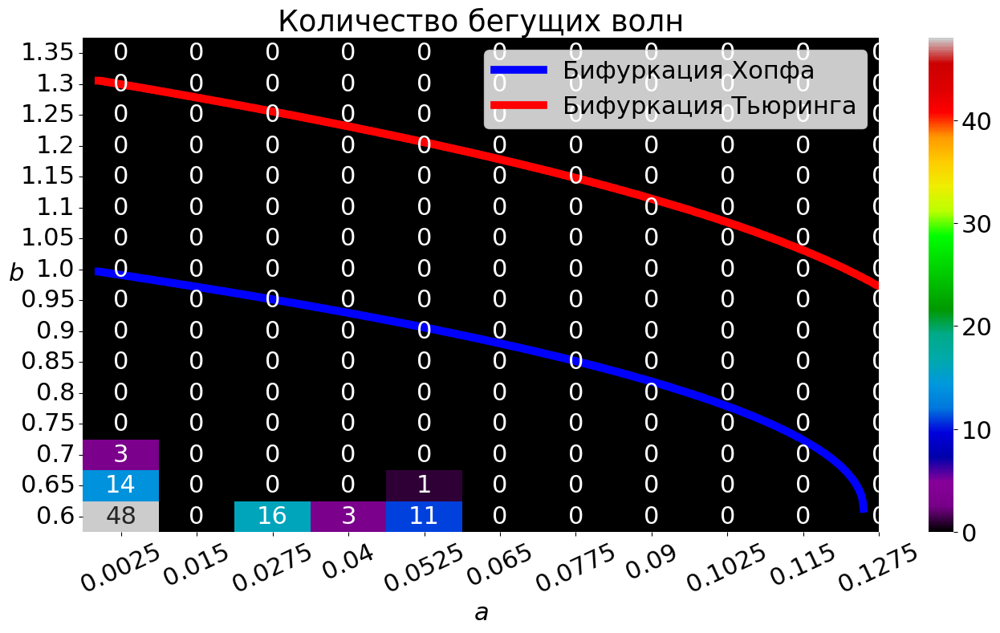

In [100]:
ax = plt.gca()
sns.heatmap(waves_count.T[::-1], ax=ax, cmap="nipy_spectral", annot=True)
print(ax.get_xticks())
print(ax.get_yticks())
ax.set_xticklabels(a_index, rotation=25)
ax.set_yticklabels(list(b_index)[::-1], rotation=0)
ax.set_ylabel("$b$", rotation=0)
ax.set_xlabel("$a$")
ax.set_title("Количество бегущих волн")
#ax.scatter(hopf_xs * 82.35,15 - (hopf_mins - 0.6)*20 + 0.5, color='b',s=40)
ax.plot(hopf_xs * 82.35,15 - (hopf_maxs - 0.6)*20 + 0.5, color='b', label = 'Бифуркация Хопфа', lw=7)
#ax.scatter(turing_xs * 82.35,15 - (turing_mins - 0.6)*20 + 0.5, color='g',s=10)
ax.plot(turing_xs * 82.35,15 - (turing_maxs - 0.6)*20 + 0.5, color='r', label = 'Бифуркация Тьюринга', lw=7)

ax.set_xlim(0,10.5)
plt.legend()

[ 0.5  1.5  2.5  3.5  4.5  5.5  6.5  7.5  8.5  9.5 10.5]
[ 0.5  1.5  2.5  3.5  4.5  5.5  6.5  7.5  8.5  9.5 10.5 11.5 12.5 13.5
 14.5 15.5]


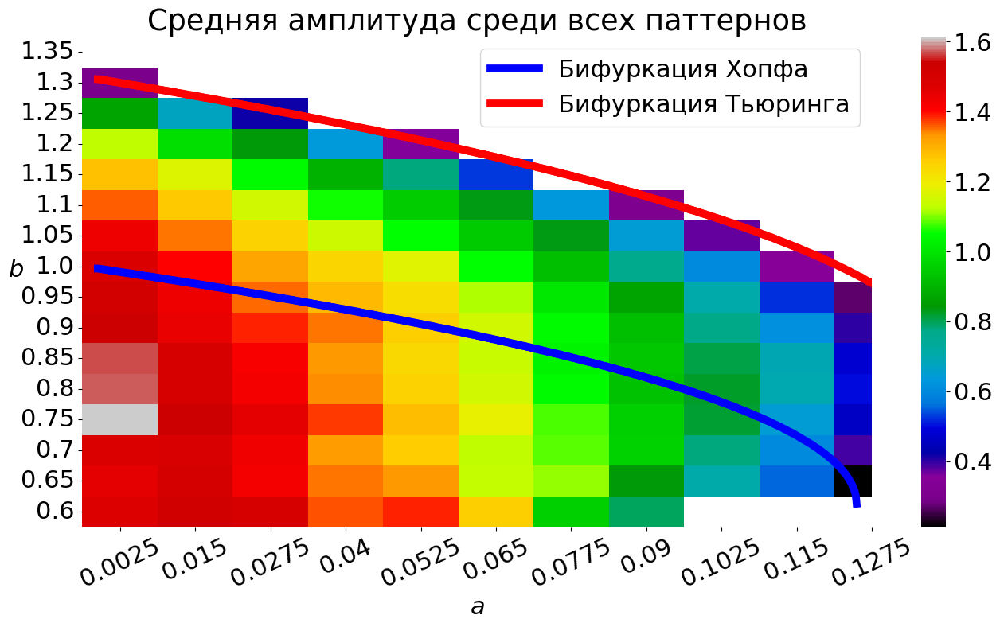

In [91]:
ax = plt.gca()
sns.heatmap(patterns_amp_mean.T[::-1], ax=ax, cmap="nipy_spectral")
print(ax.get_xticks())
print(ax.get_yticks())
ax.set_xticklabels(a_index, rotation=25)
ax.set_yticklabels(list(b_index)[::-1], rotation=0)
ax.set_ylabel("$b$", rotation=0)
ax.set_xlabel("$a$")
ax.set_title("Средняя амплитуда среди всех паттернов")
#ax.scatter(hopf_xs * 82.35,15 - (hopf_mins - 0.6)*20 + 0.5, color='b',s=40)
ax.plot(hopf_xs * 82.35,15 - (hopf_maxs - 0.6)*20 + 0.5, color='b', label = 'Бифуркация Хопфа', lw=7)
#ax.scatter(turing_xs * 82.35,15 - (turing_mins - 0.6)*20 + 0.5, color='g',s=10)
ax.plot(turing_xs * 82.35,15 - (turing_maxs - 0.6)*20 + 0.5, color='r', label = 'Бифуркация Тьюринга', lw=7)

ax.set_xlim(0,10.5)
plt.legend()
plt.show()

[ 0.5  1.5  2.5  3.5  4.5  5.5  6.5  7.5  8.5  9.5 10.5]
[ 0.5  1.5  2.5  3.5  4.5  5.5  6.5  7.5  8.5  9.5 10.5 11.5 12.5 13.5
 14.5 15.5]


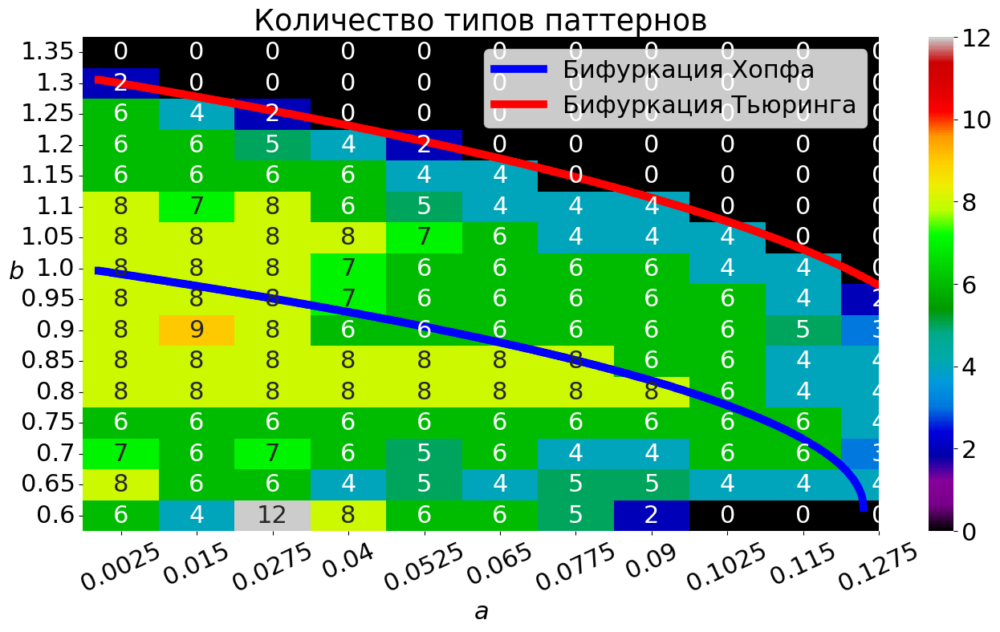

In [92]:
ax = plt.gca()
sns.heatmap(pattern_types_count.T[::-1], ax=ax, cmap="nipy_spectral", annot=True)
print(ax.get_xticks())
print(ax.get_yticks())
ax.set_xticklabels(a_index, rotation=25)
ax.set_yticklabels(list(b_index)[::-1], rotation=0)
ax.set_ylabel("$b$", rotation=0)
ax.set_xlabel("$a$")
ax.set_title("Количество типов паттернов")
#ax.scatter(hopf_xs * 82.35,15 - (hopf_mins - 0.6)*20 + 0.5, color='b',s=40)
ax.plot(hopf_xs * 82.35,15 - (hopf_maxs - 0.6)*20 + 0.5, color='b', label = 'Бифуркация Хопфа', lw=7)
#ax.scatter(turing_xs * 82.35,15 - (turing_mins - 0.6)*20 + 0.5, color='g',s=10)
ax.plot(turing_xs * 82.35,15 - (turing_maxs - 0.6)*20 + 0.5, color='r', label = 'Бифуркация Тьюринга', lw=7)

ax.set_xlim(0,10.5)
plt.legend()
plt.show()

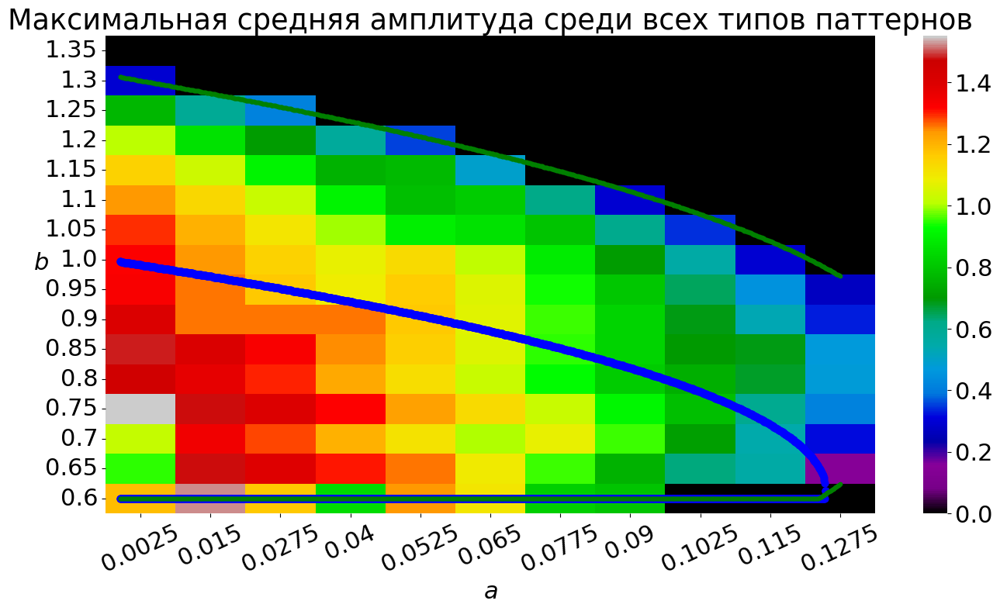

In [21]:
ax = plt.gca()
sns.heatmap(patterns_amp_max.T[::-1], ax=ax,cmap='nipy_spectral')
ax.set_xticklabels(a_index, rotation=25)
ax.set_yticklabels(list(b_index)[::-1], rotation=0)
ax.set_ylabel('$b$', rotation=0)
ax.set_xlabel('$a$')
ax.set_title("Максимальная средняя амплитуда среди всех типов паттернов")
ax.scatter(hopf_xs * 82.35,15 - (hopf_mins - 0.6)*20 + 0.5, color='b',s=40)
ax.scatter(hopf_xs * 82.35,15 - (hopf_maxs - 0.6)*20 + 0.5, color='b',s=40)
ax.scatter(turing_xs * 82.35,15 - (turing_mins - 0.6)*20 + 0.5, color='g',s=10)
ax.scatter(turing_xs * 82.35,15 - (turing_maxs - 0.6)*20 + 0.5, color='g',s=10)

/tmp/ipykernel_81496/1842898249.py:2: RuntimeWarning: invalid value encountered in true_divide
  sns.heatmap(patterns_amp_delta.T[::-1] / patterns_amp_max.T[::-1], ax=ax,cmap='nipy_spectral')


Text(0.5, 1.0, 'Максимум относительной дельты амплитуд среди всех типов паттернов')

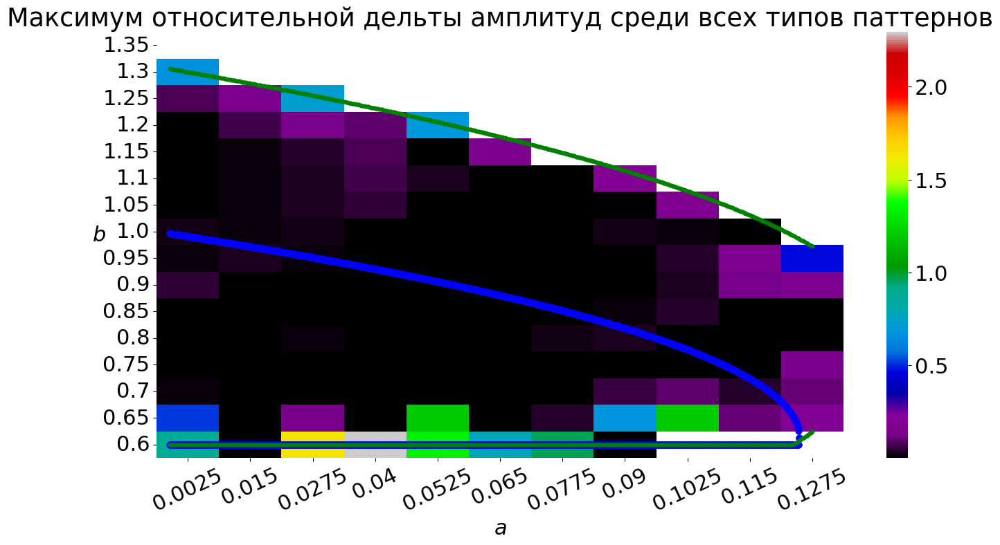

In [22]:
ax = plt.gca()
sns.heatmap(patterns_amp_delta.T[::-1] / patterns_amp_max.T[::-1], ax=ax,cmap='nipy_spectral')
ax.set_xticklabels(a_index, rotation=25)
ax.set_yticklabels(list(b_index)[::-1], rotation=0)
ax.set_ylabel('$b$', rotation=0)
ax.set_xlabel('$a$')
ax.scatter(hopf_xs * 82.35,15 - (hopf_mins - 0.6)*20 + 0.5, color='b',s=40)
ax.scatter(hopf_xs * 82.35,15 - (hopf_maxs - 0.6)*20 + 0.5, color='b',s=40)
ax.scatter(turing_xs * 82.35,15 - (turing_mins - 0.6)*20 + 0.5, color='g',s=10)
ax.scatter(turing_xs * 82.35,15 - (turing_maxs - 0.6)*20 + 0.5, color='g',s=10)
ax.set_title("Максимум относительной дельты амплитуд среди всех типов паттернов")


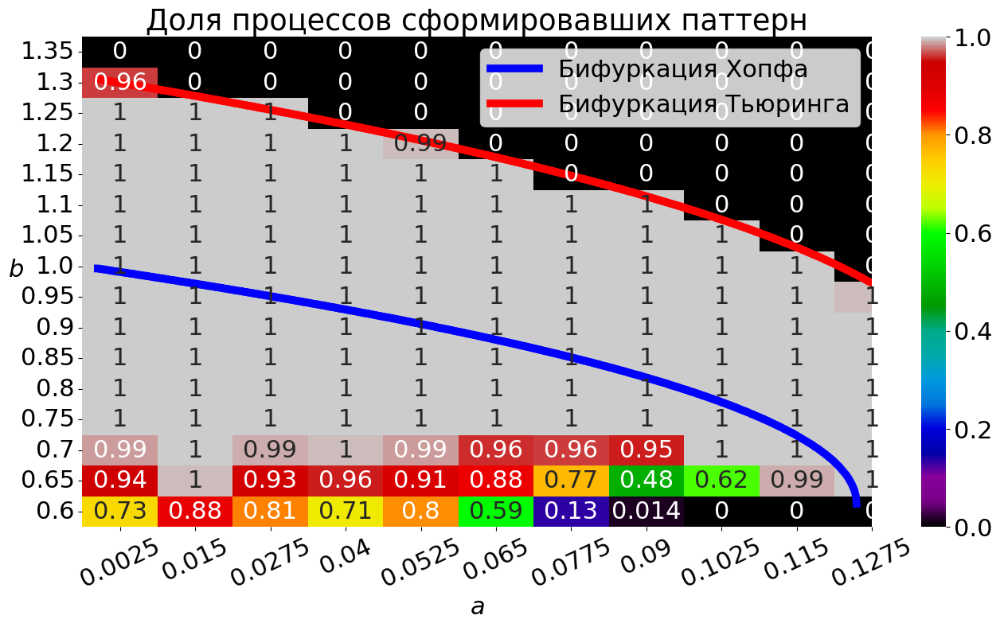

In [29]:
ax = plt.gca()
sns.heatmap(patterns_count.T[::-1]/500, ax=ax,cmap='nipy_spectral', annot=True)
ax.set_xticklabels(a_index, rotation=25)
ax.set_yticklabels(list(b_index)[::-1], rotation=0)
ax.set_ylabel('$b$', rotation=0)
ax.set_xlabel('$a$')
#ax.scatter(hopf_xs * 82.35,15 - (hopf_mins - 0.6)*20 + 0.5, color='b',s=40)
ax.plot(hopf_xs * 82.35,15 - (hopf_maxs - 0.6)*20 + 0.5, color='b', label = 'Бифуркация Хопфа', lw=7)
#ax.scatter(turing_xs * 82.35,15 - (turing_mins - 0.6)*20 + 0.5, color='g',s=10)
ax.plot(turing_xs * 82.35,15 - (turing_maxs - 0.6)*20 + 0.5, color='r', label = 'Бифуркация Тьюринга', lw=7)

ax.set_title("Доля процессов сформировавших паттерн")
ax.set_xlim(0,10.5)
plt.legend()
plt.show()



In [ ]:
len()

500

100%|██████████| 500/500 [00:00<00:00, 6073.37it/s]


/home/alexander/miniconda3/lib/python3.9/site-packages/seaborn/categorical.py:3540: UserWarning: 25.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


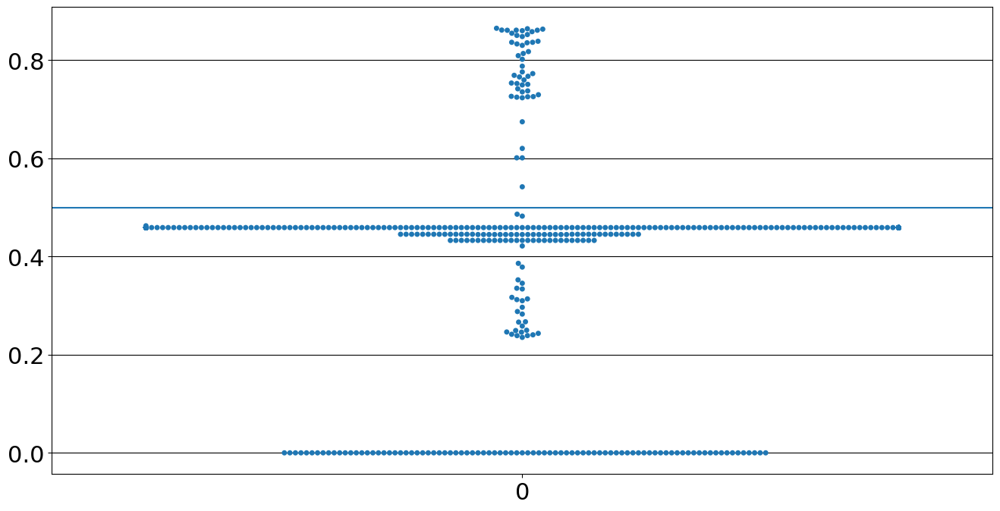

In [ ]:
points = defaultdict(list)

for e in tqdm(params_to_exps[(0.0025, 0.6)]):
    cfs = calc_multiple_Fourier_coeffs(e.end_values['u'], e.method_parameters['dx'], FOURIER_KS).values()
    points[np.std(list(cfs))].append(e)
sns.swarmplot(points.keys())
plt.gca().axhline(.5)

100%|██████████| 500/500 [00:00<00:00, 8863.25it/s]


/home/alexander/miniconda3/lib/python3.9/site-packages/seaborn/categorical.py:3540: UserWarning: 44.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


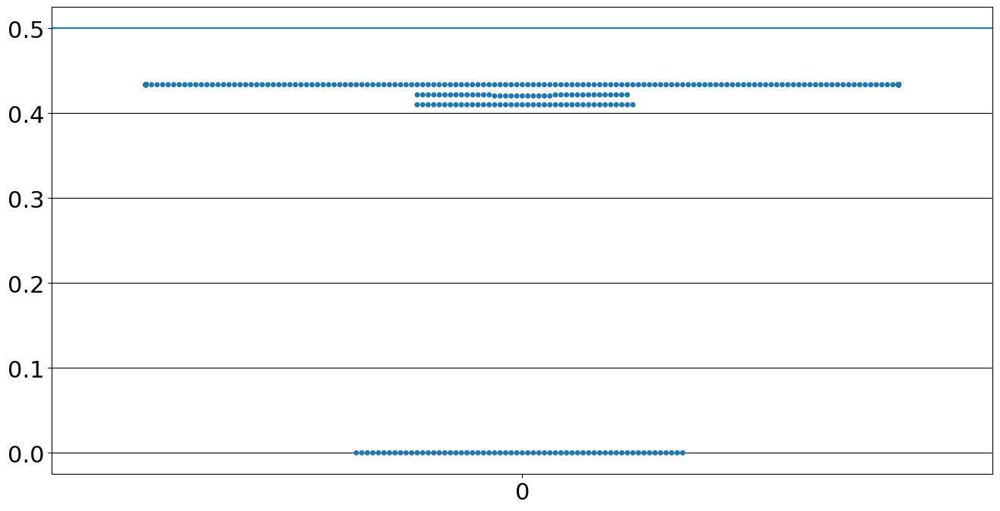

In [ ]:
points = defaultdict(list)

for e in tqdm(params_to_exps[(0.015, 0.6)]):
    cfs = calc_multiple_Fourier_coeffs(e.end_values['u'], e.method_parameters['dx'], FOURIER_KS).values()
    points[np.std(list(cfs))].append(e)
sns.swarmplot(points.keys())
plt.gca().axhline(.5)

25it [01:12,  2.91s/it]


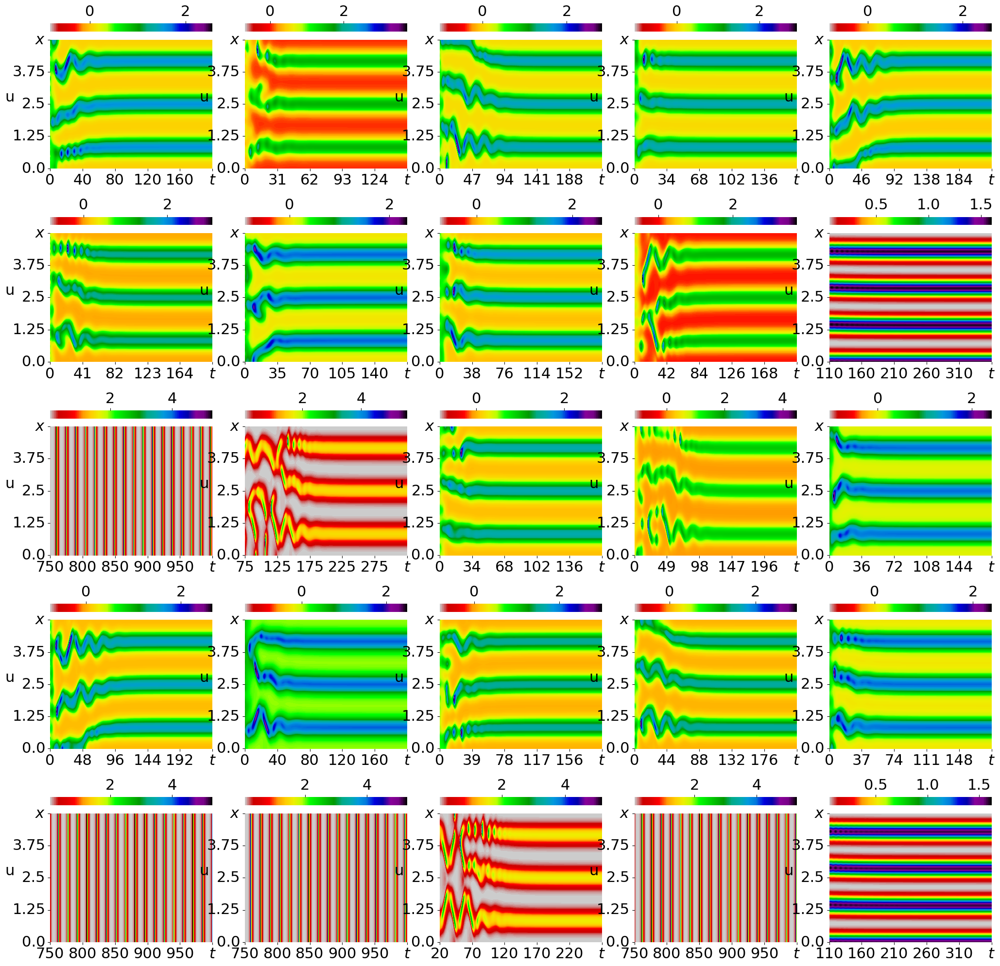

In [ ]:
fig, axes = plt.subplots(5,5,figsize=(25,25))

for ax, e in tqdm(zip(axes.flatten(), random.sample(params_to_exps[(0.015, 0.6)], 25))):
    cur_e = Experiment().fill_from(e.path_to_file, load_timelines=True)
    end = cur_e.timelines['u'].shape[0] * cur_e.method_parameters['dt'] * cur_e.method_parameters['timeline_save_step_delta']
    draw_transient(cur_e, left_border=max(0, end - 250), right_border=end,ax=ax)
plt.show()

25it [01:19,  3.19s/it]


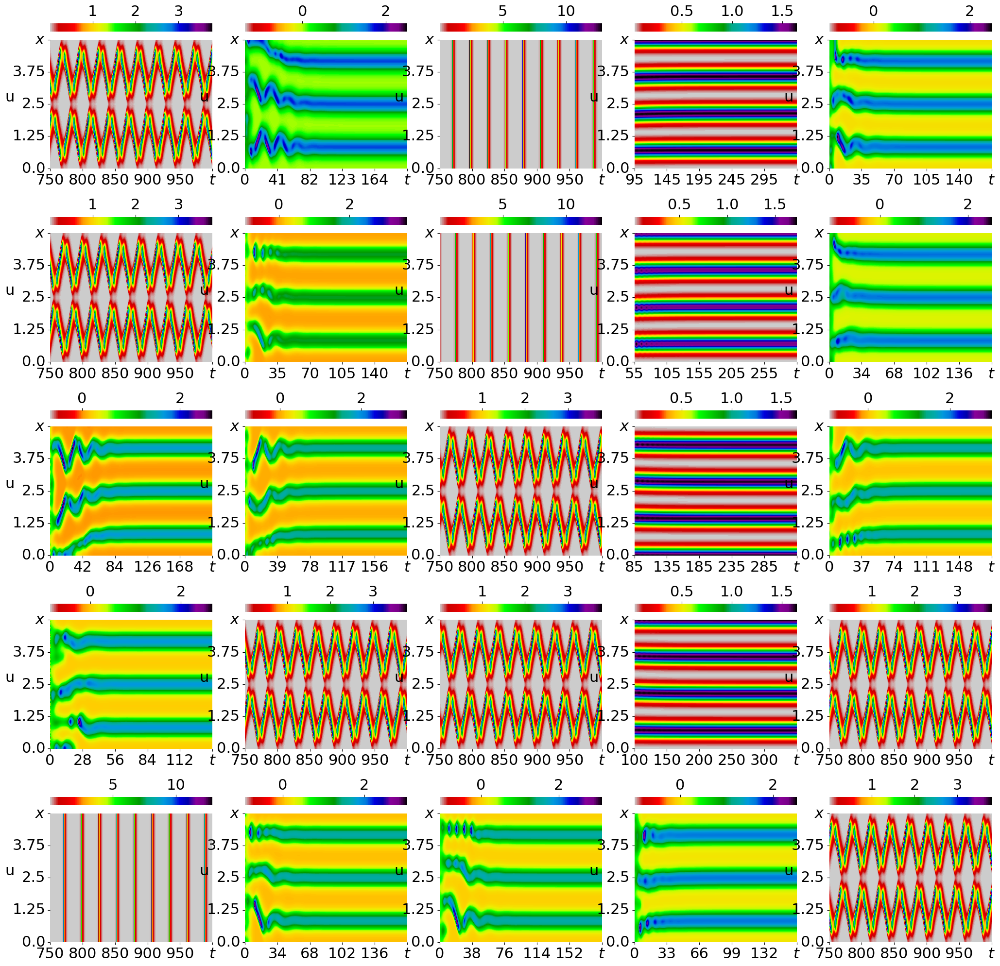

In [ ]:
fig, axes = plt.subplots(5,5,figsize=(25,25))

for ax, e in tqdm(zip(axes.flatten(), random.sample(params_to_exps[(0.0025, 0.6)], 25))):
    cur_e = Experiment().fill_from(e.path_to_file, load_timelines=True)
    end = cur_e.timelines['u'].shape[0] * cur_e.method_parameters['dt'] * cur_e.method_parameters['timeline_save_step_delta']
    draw_transient(cur_e, left_border=max(0, end - 250), right_border=end,ax=ax)
plt.show()

<AxesSubplot:ylabel='u'>

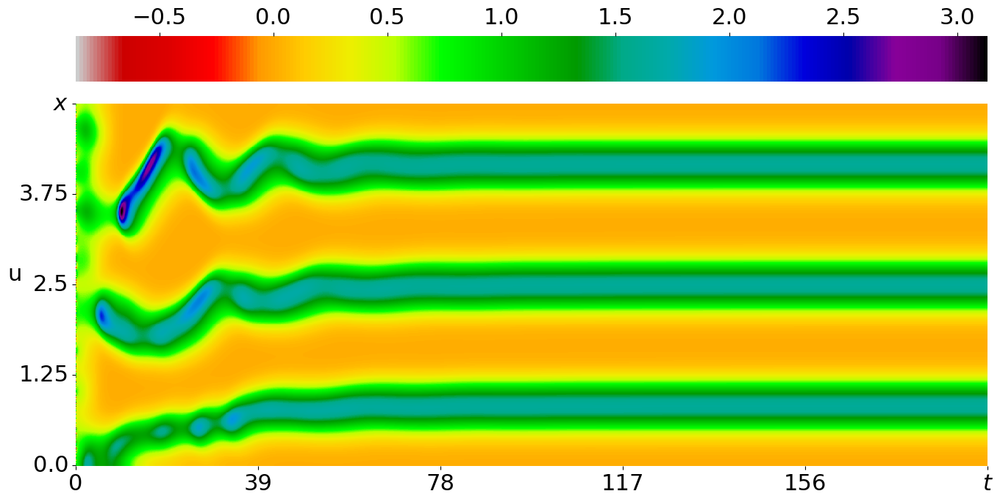

In [53]:
draw_transient(exxx1, 'u', right_border=300)

In [56]:
wat = check_robustness(exxx1.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme)

Good /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/0_3


<AxesSubplot:ylabel='u'>

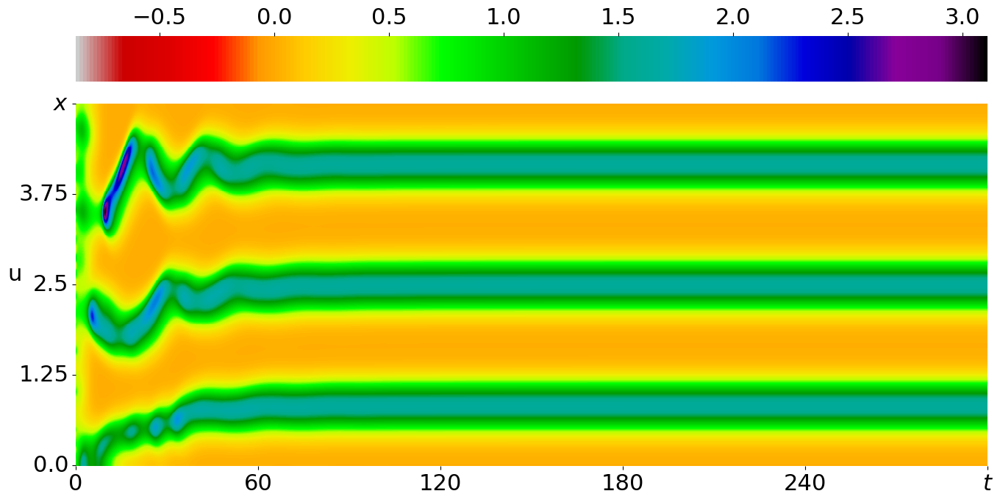

In [57]:
draw_transient(wat[1], 'u', right_border=300)

0


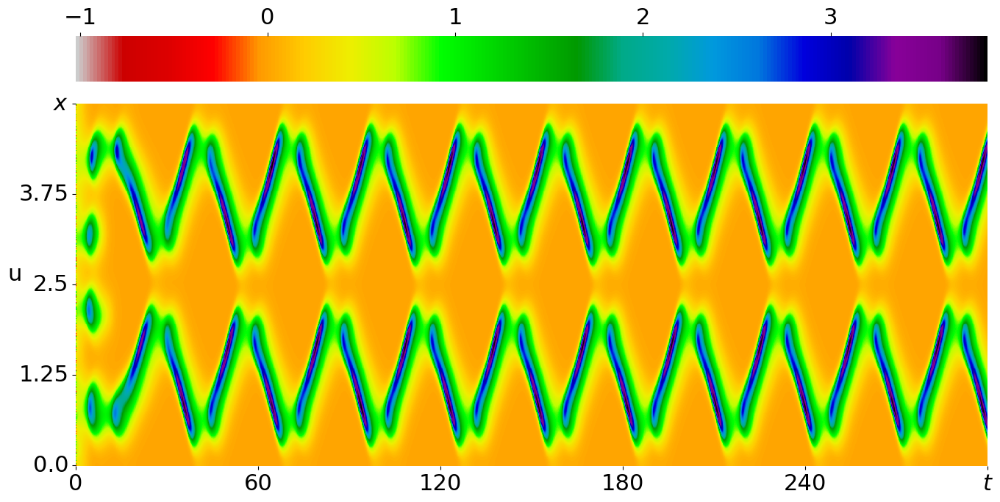

1


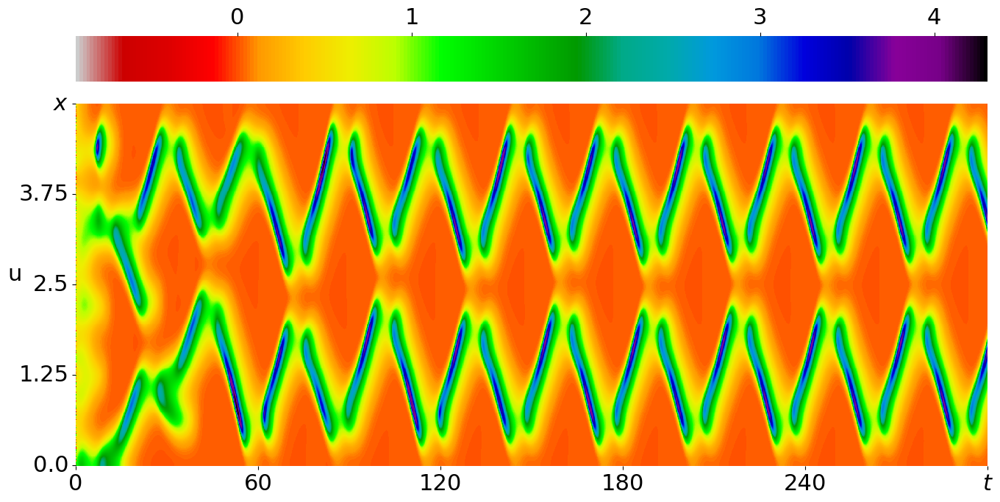

2


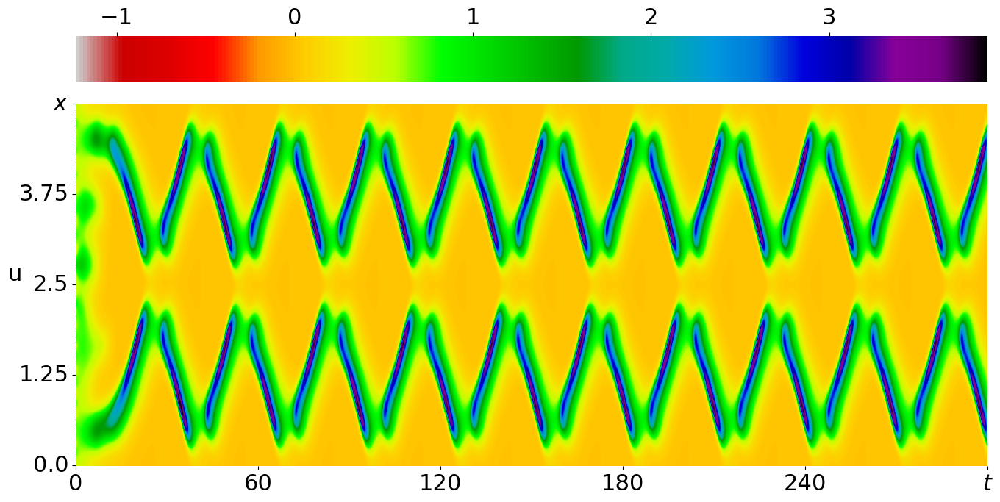

3


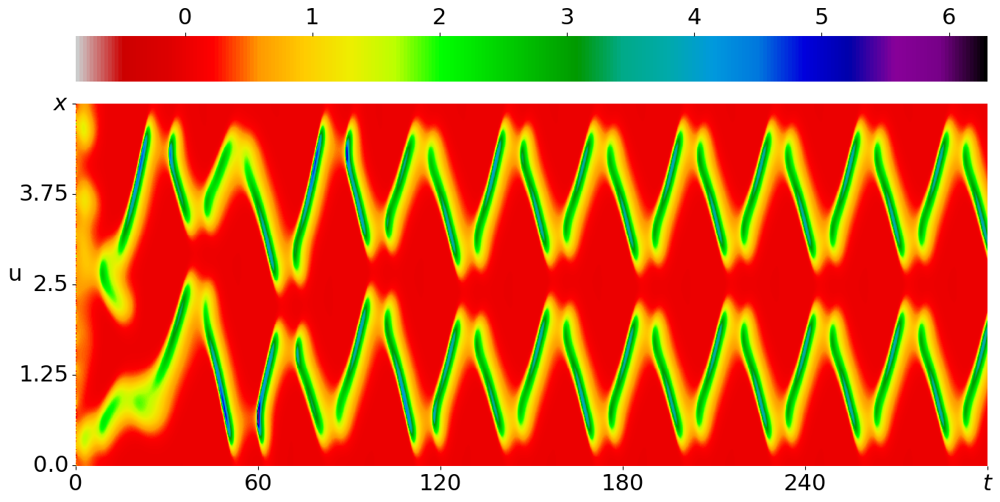

4


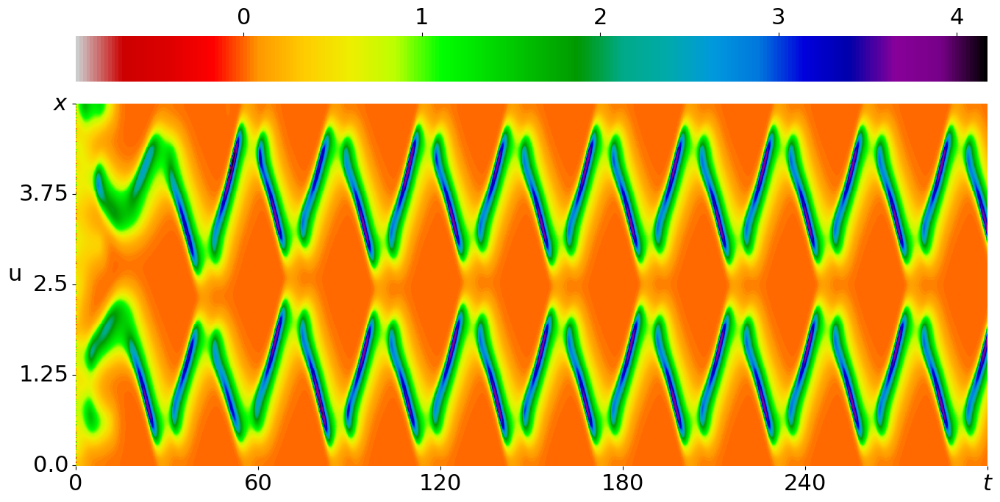

5


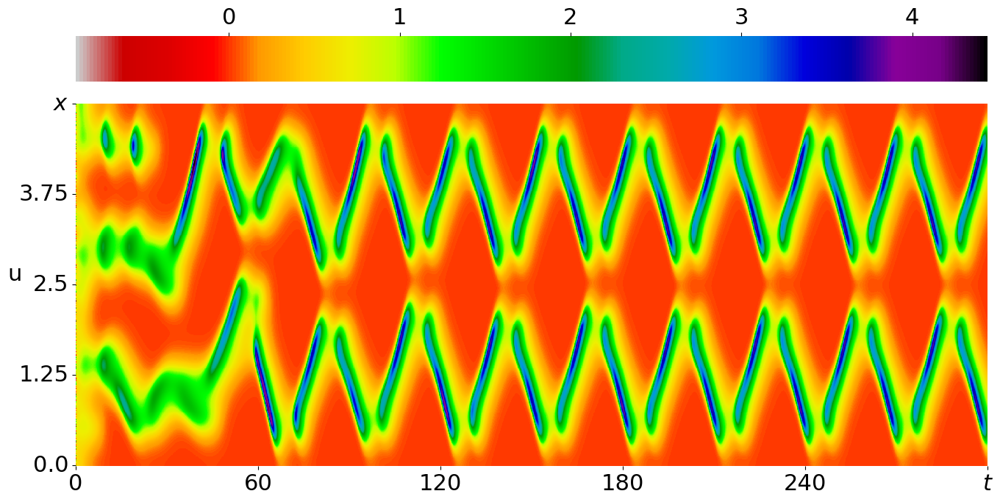

6


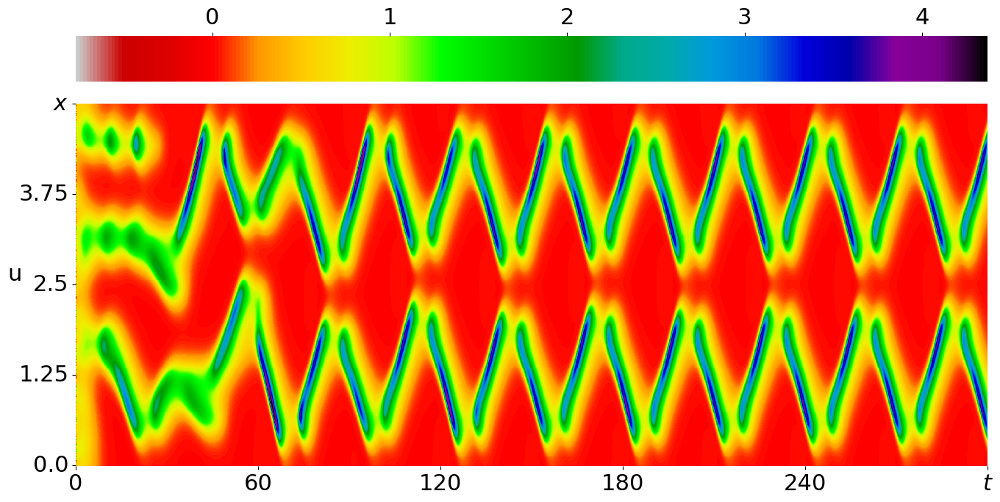

7


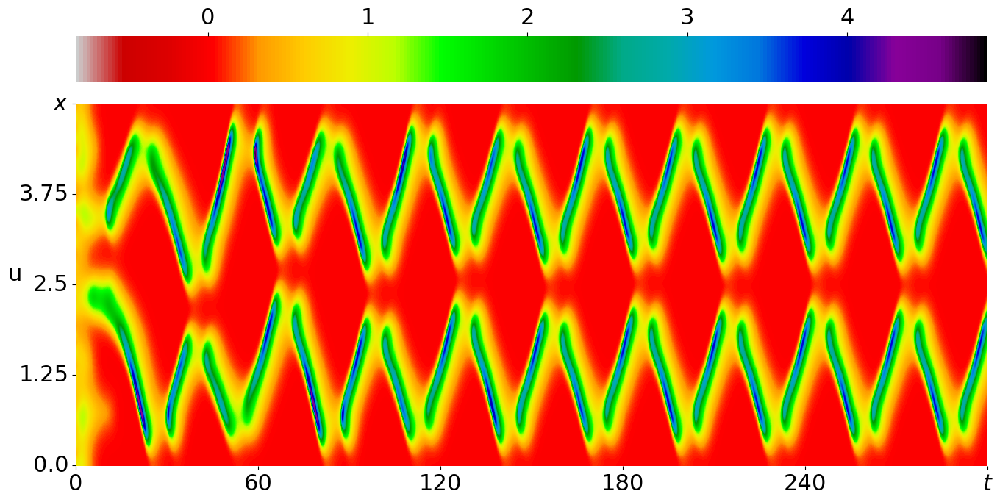

8


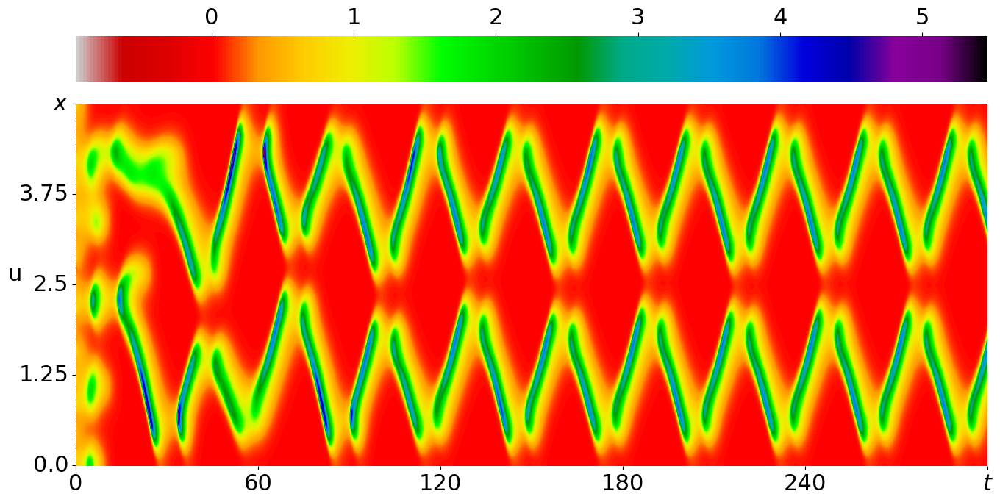

9


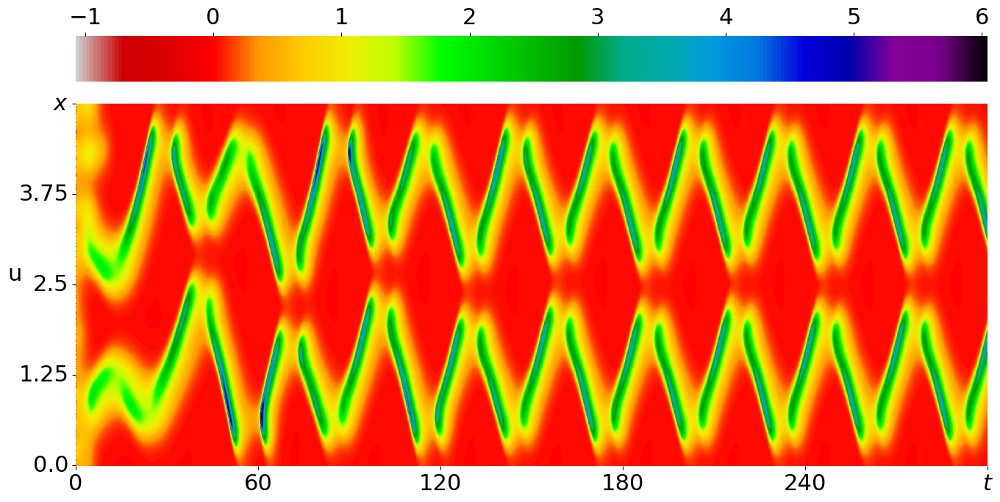

10


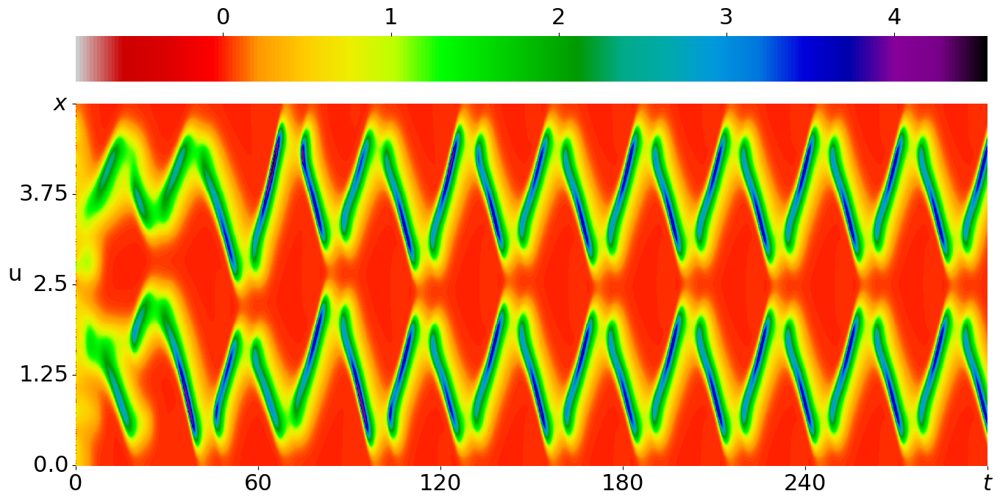

11


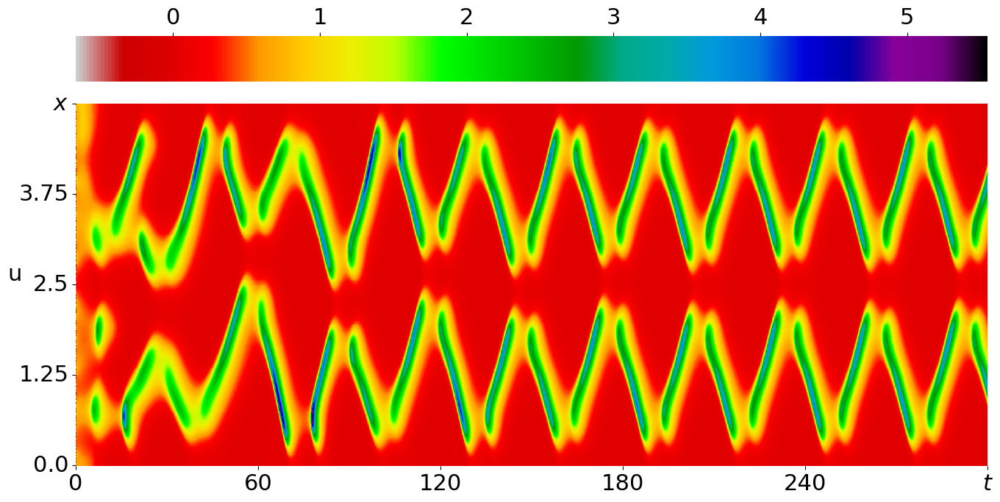

12


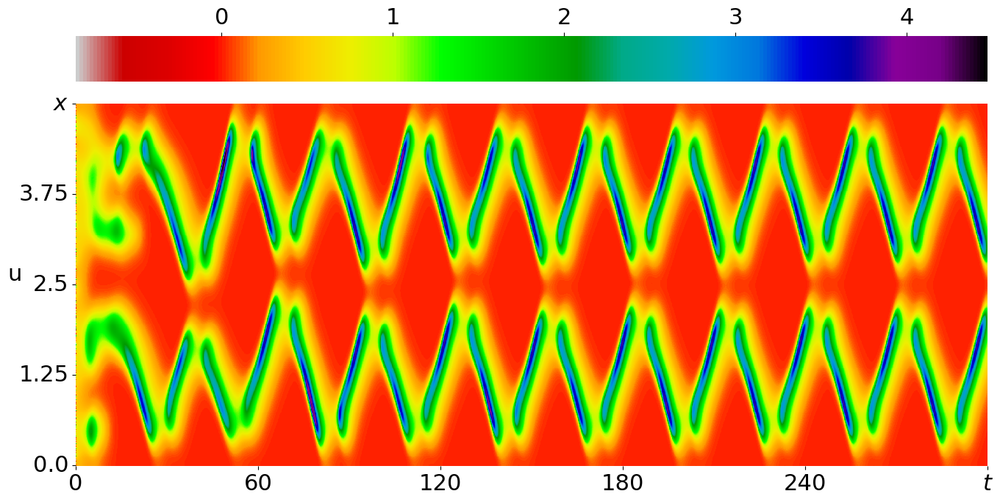

13


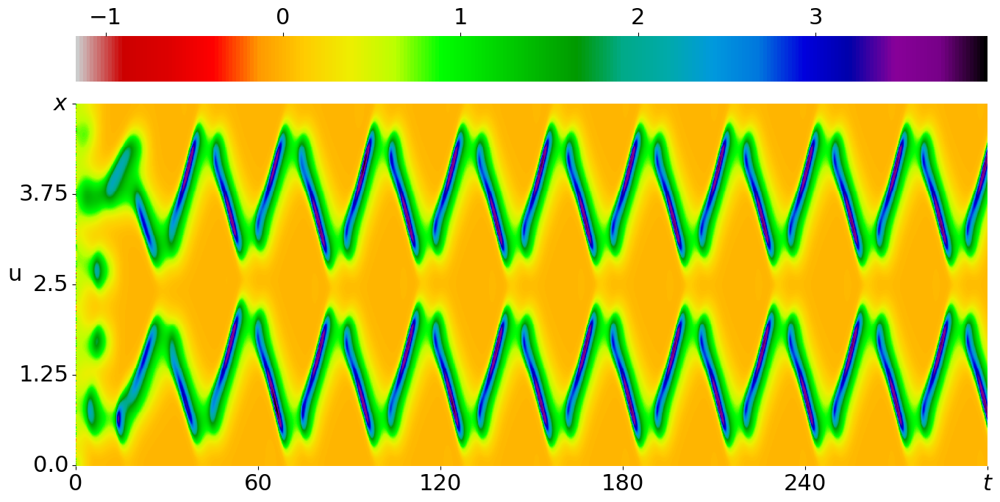

14


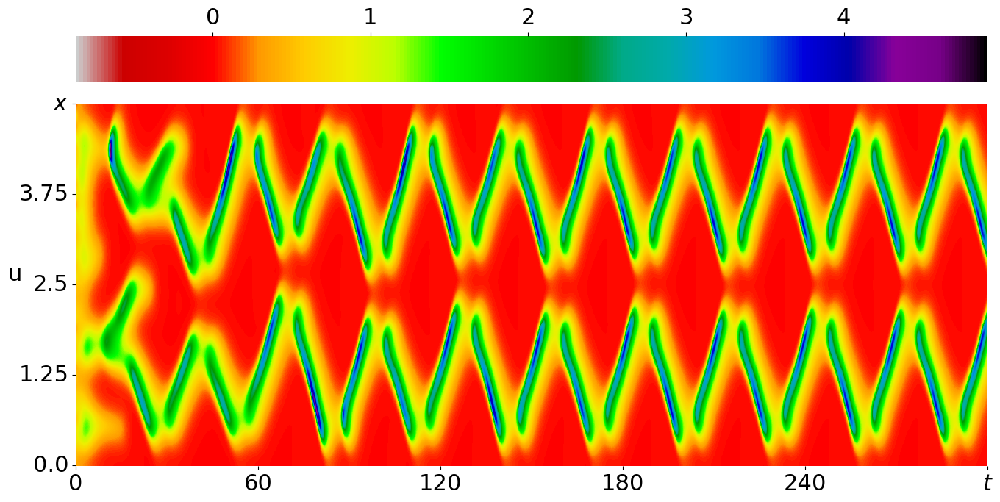

15


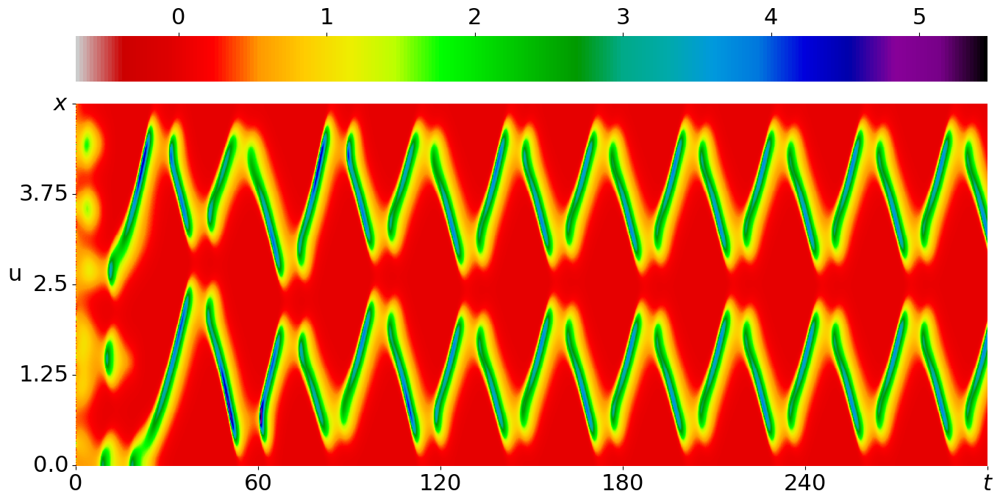

16


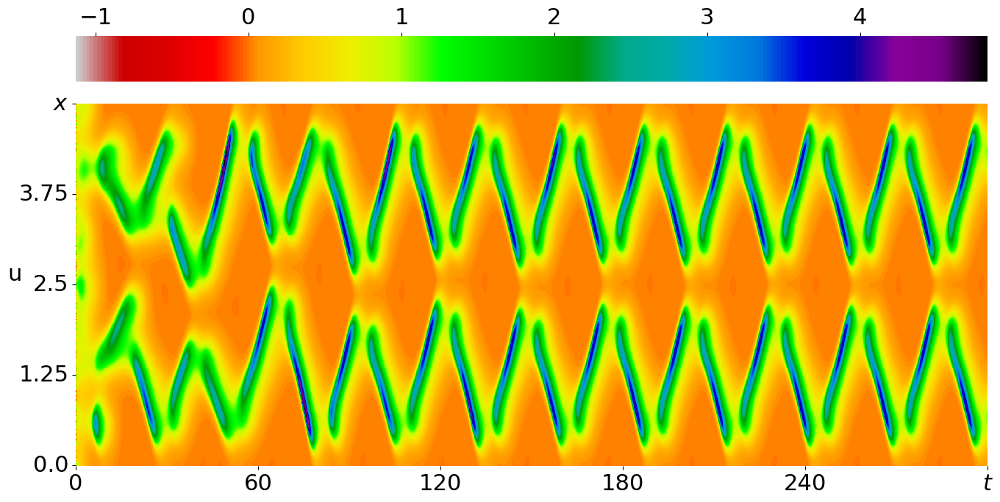

17


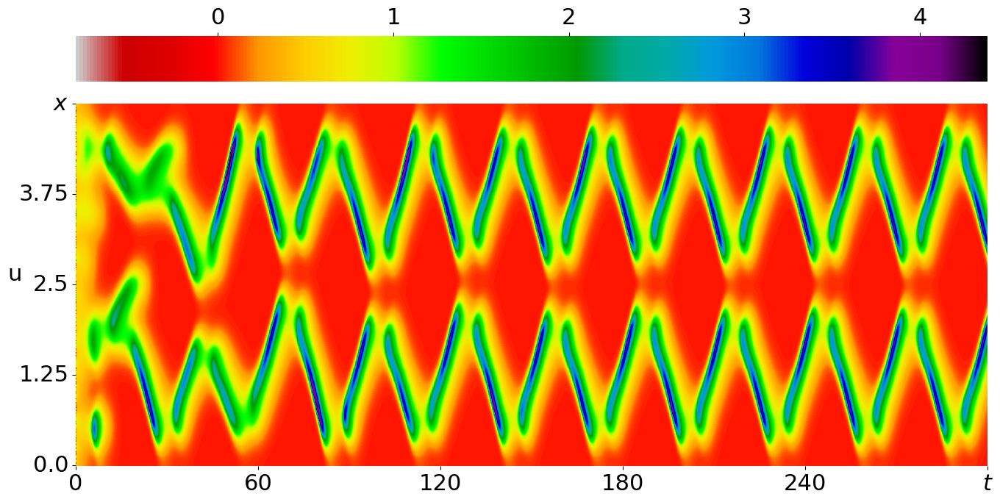

18


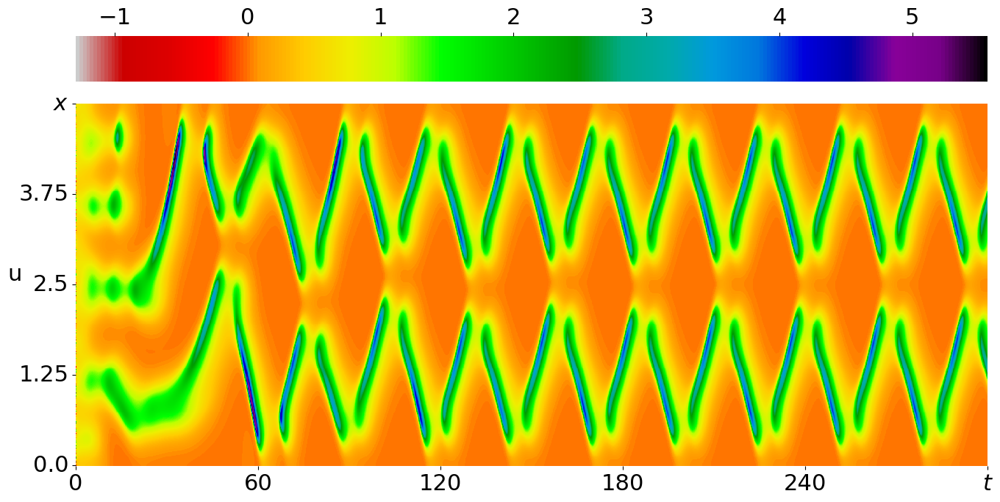

19


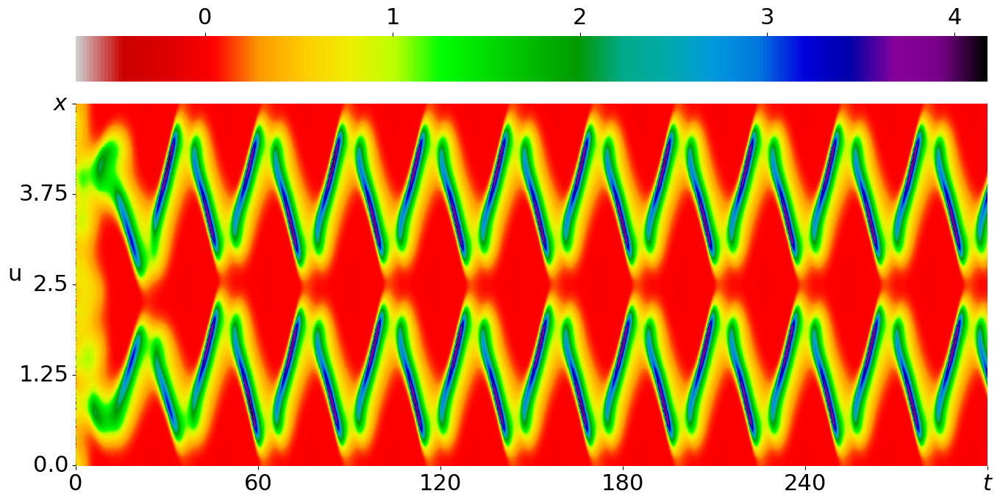

20


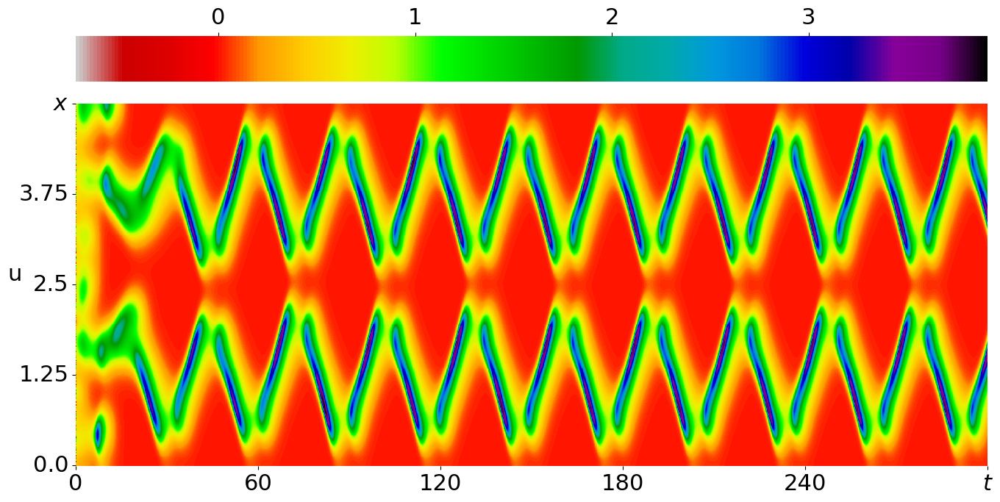

21


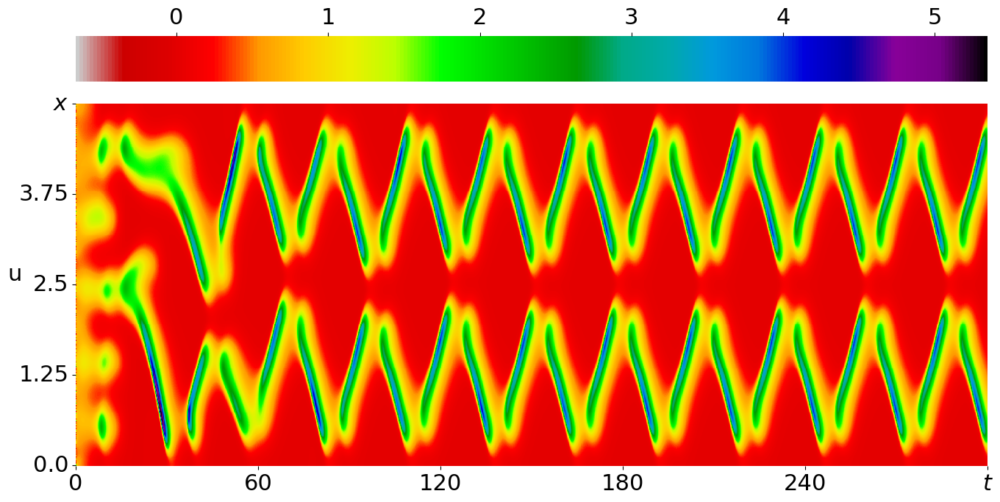

22


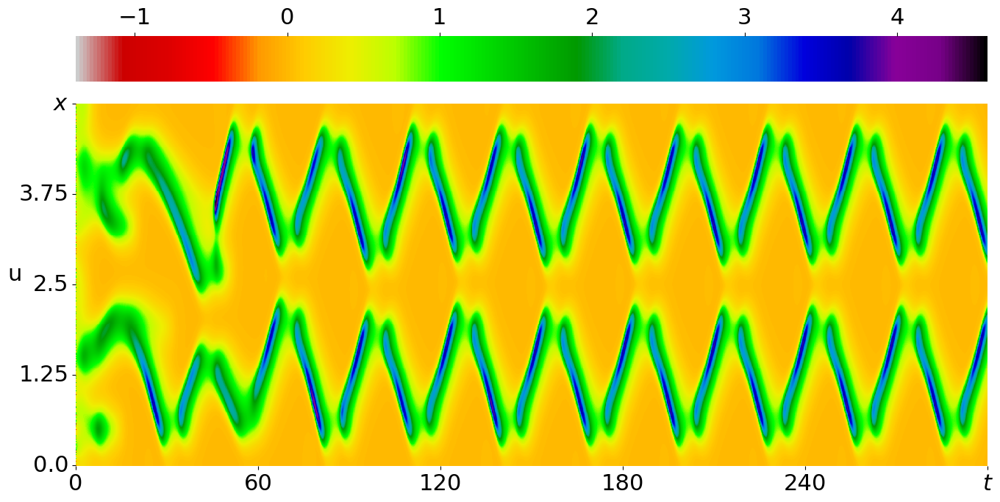

23


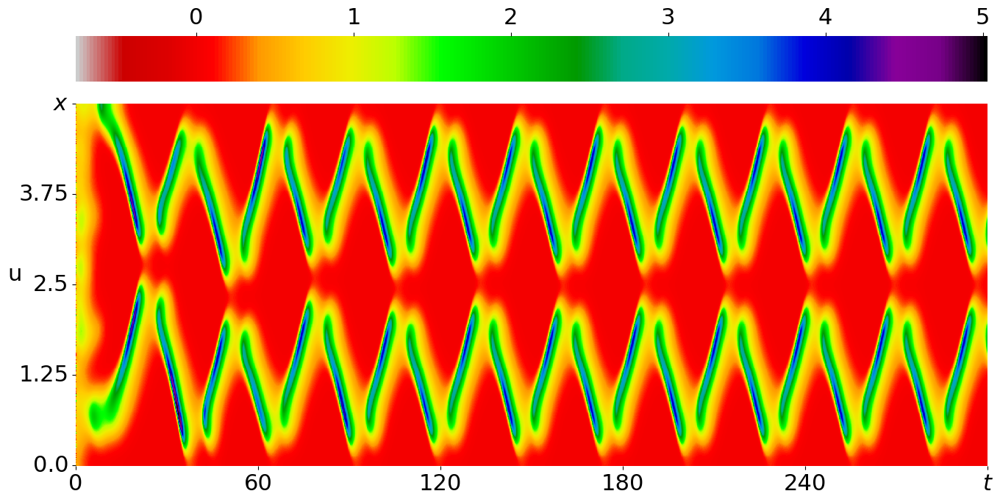

24


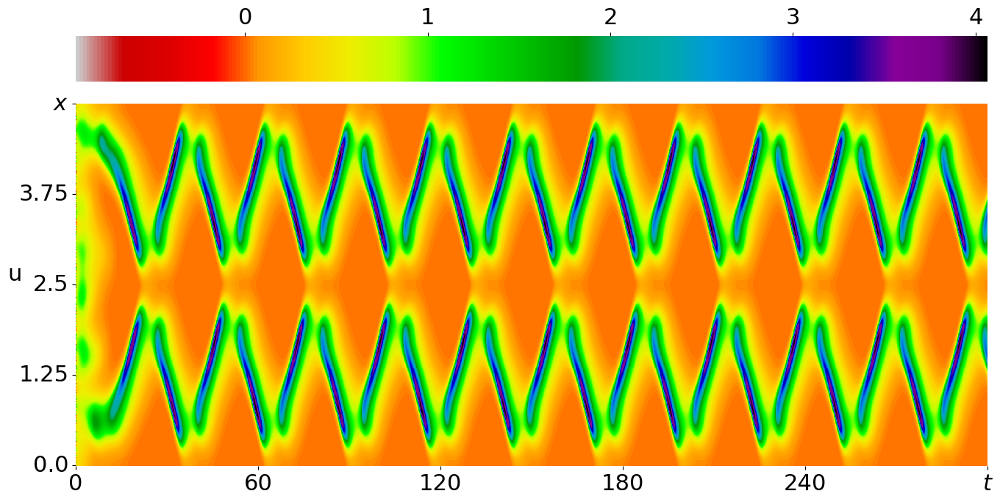

25


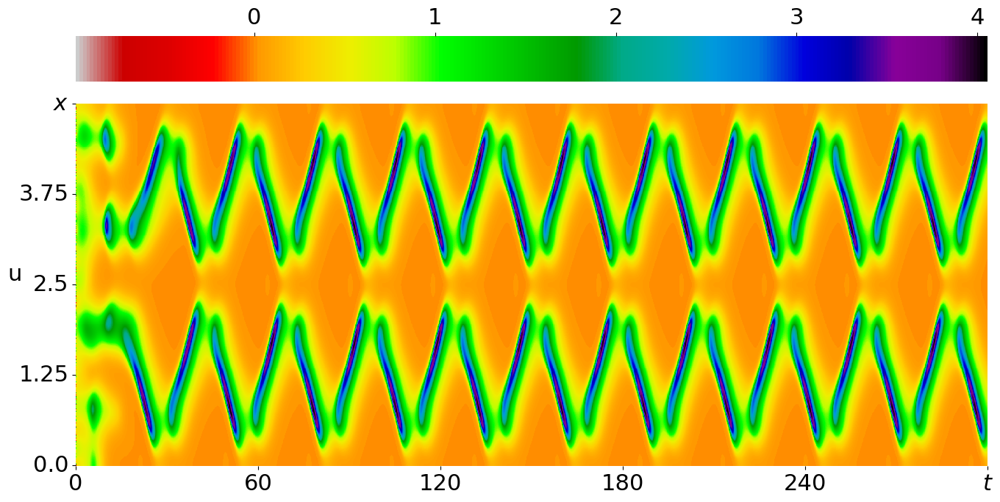

26


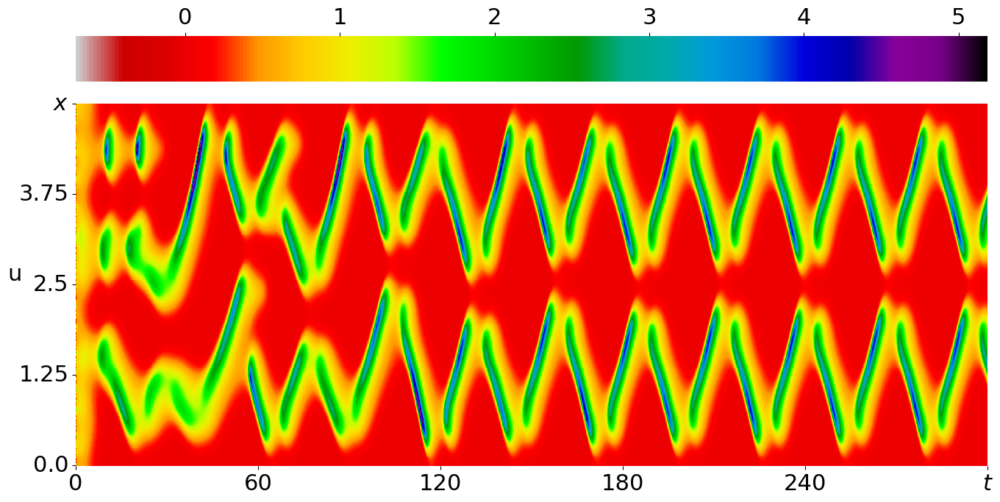

27


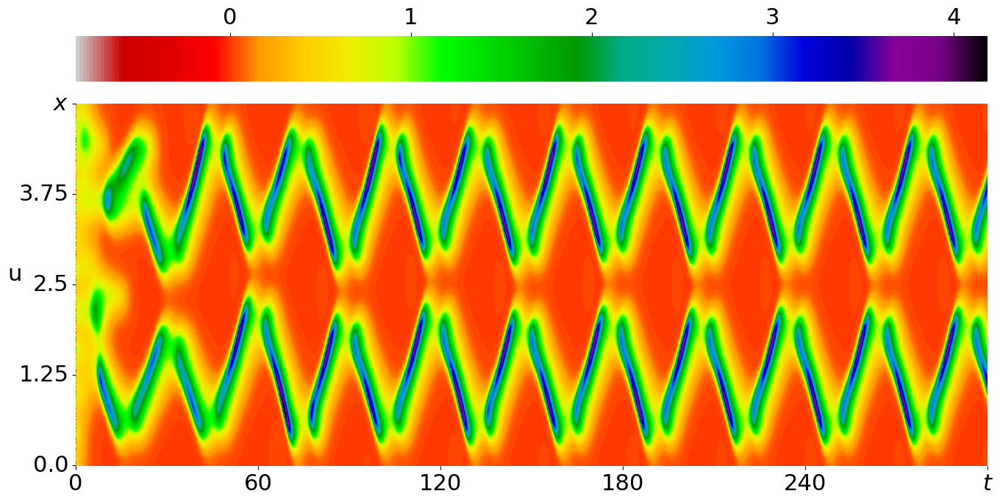

28


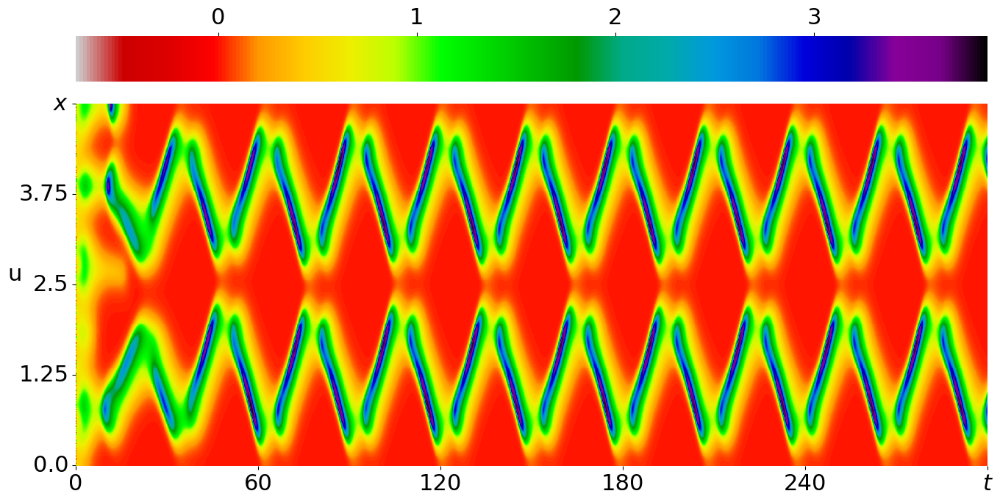

29


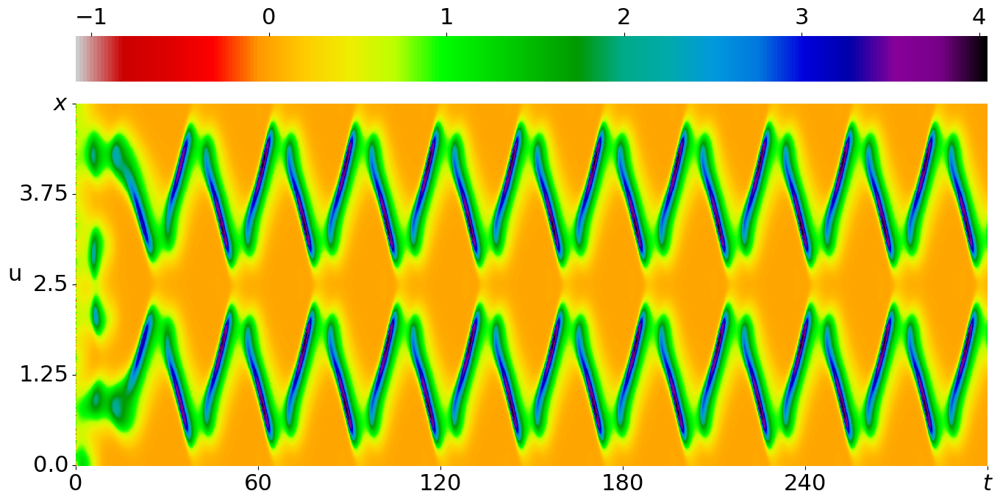

30


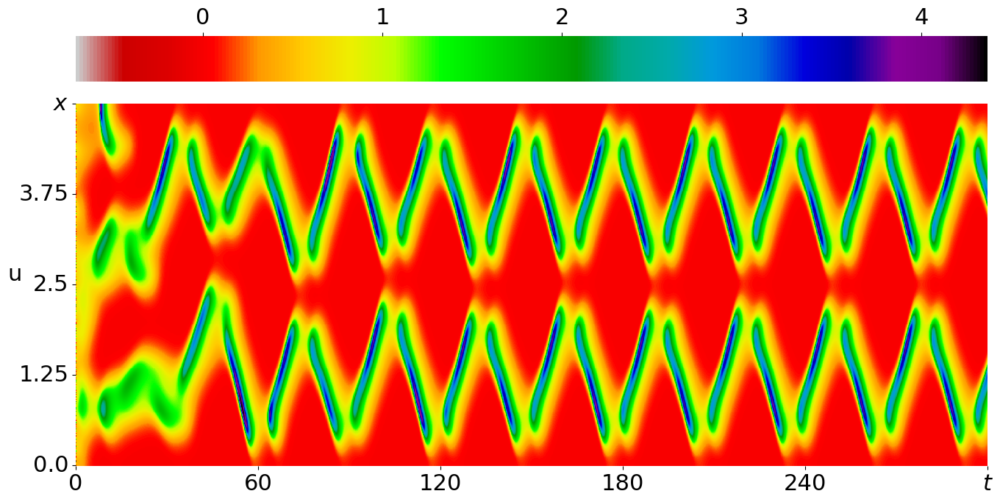

31


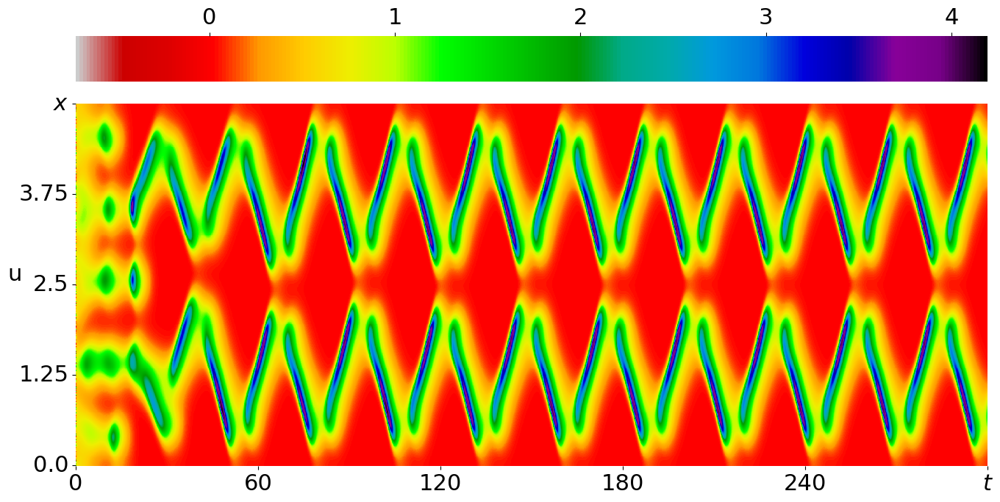

32


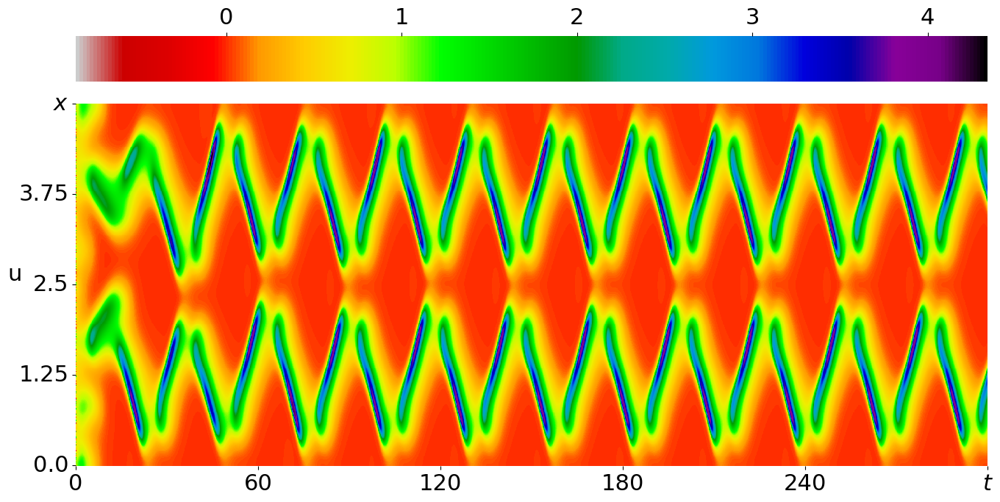

33


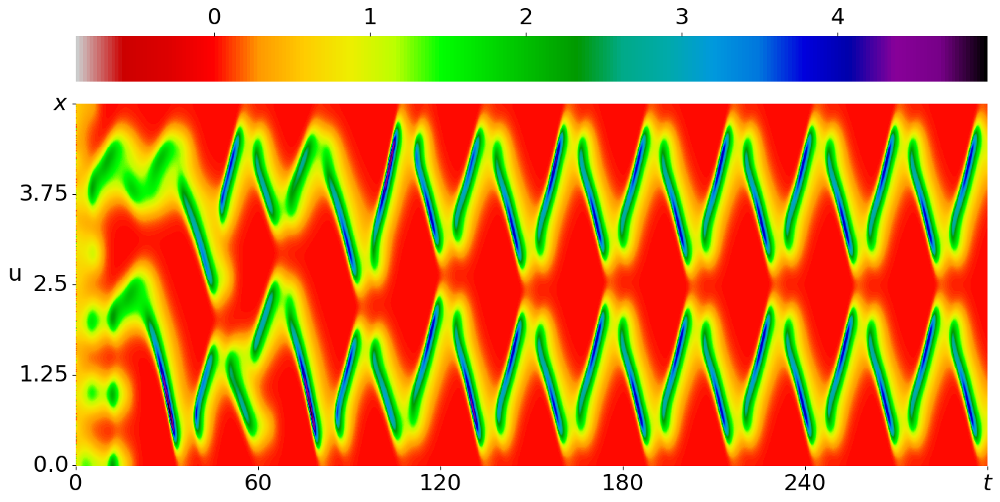

34


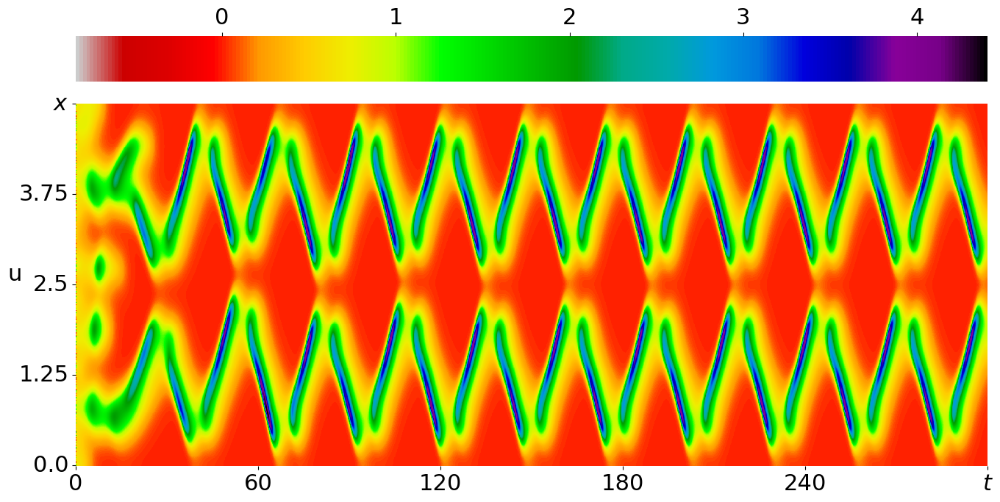

35


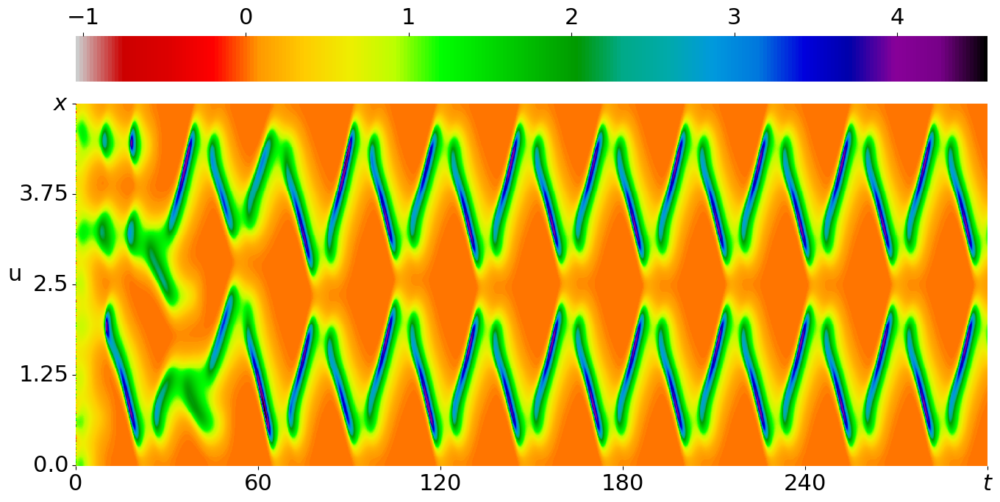

36


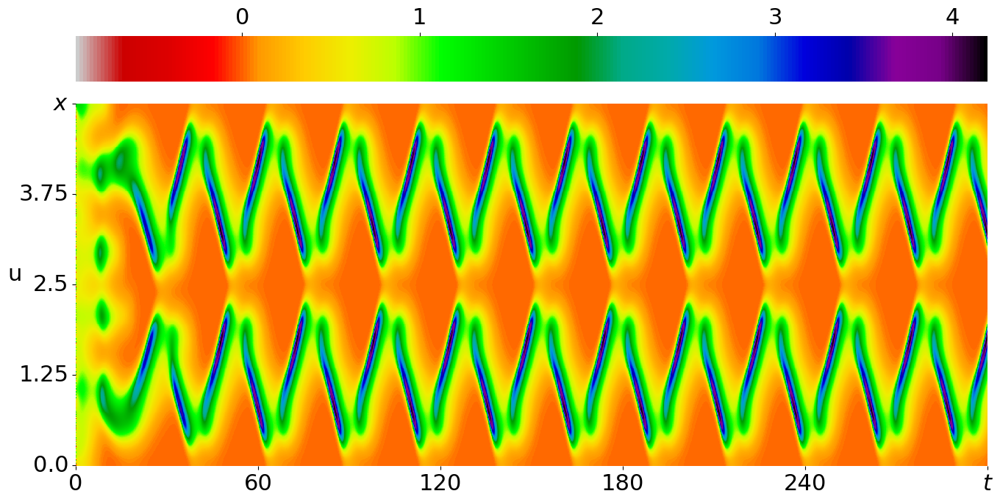

37


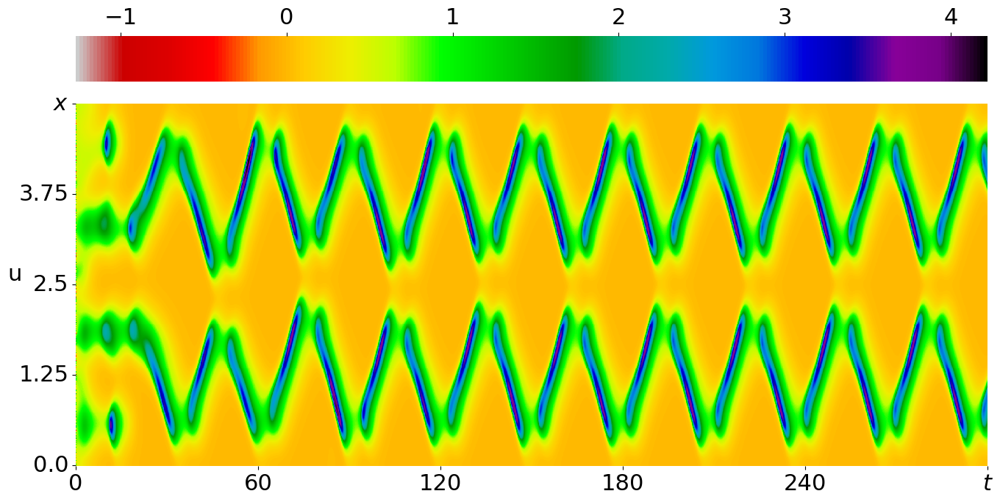

38


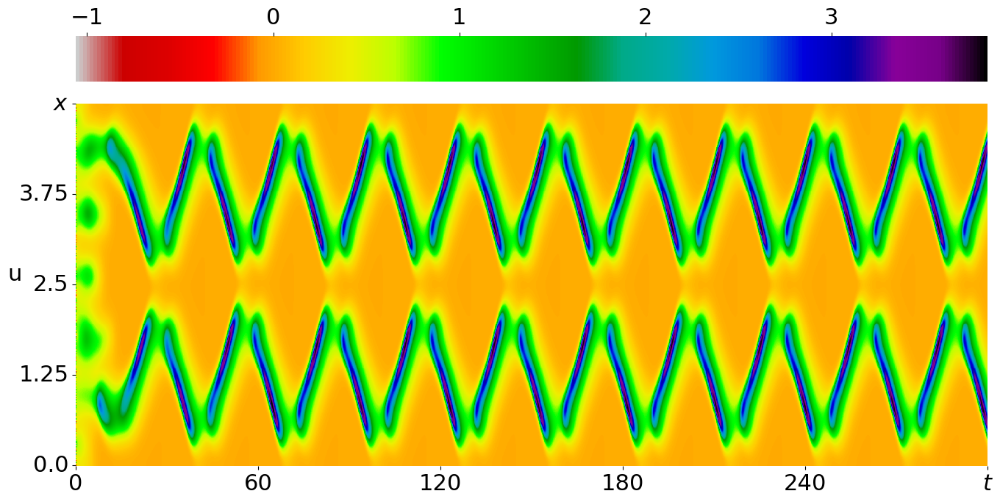

39


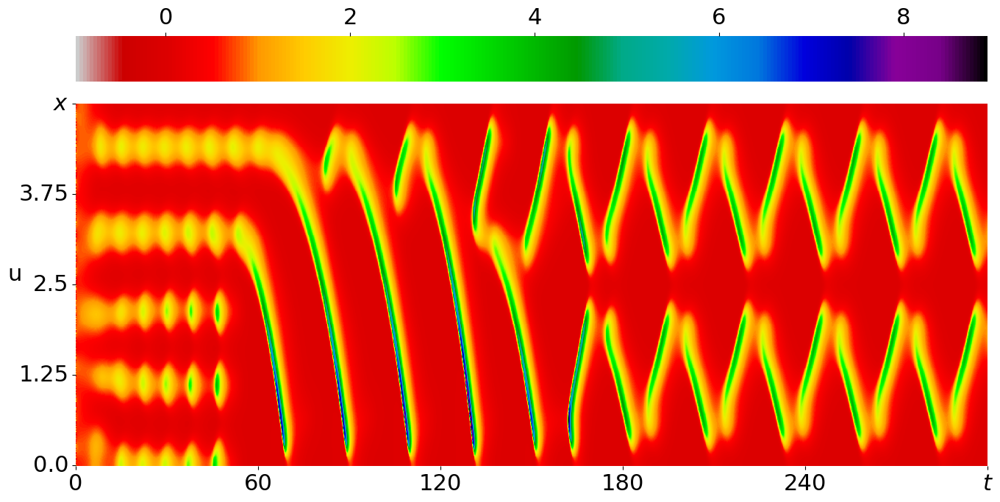

40


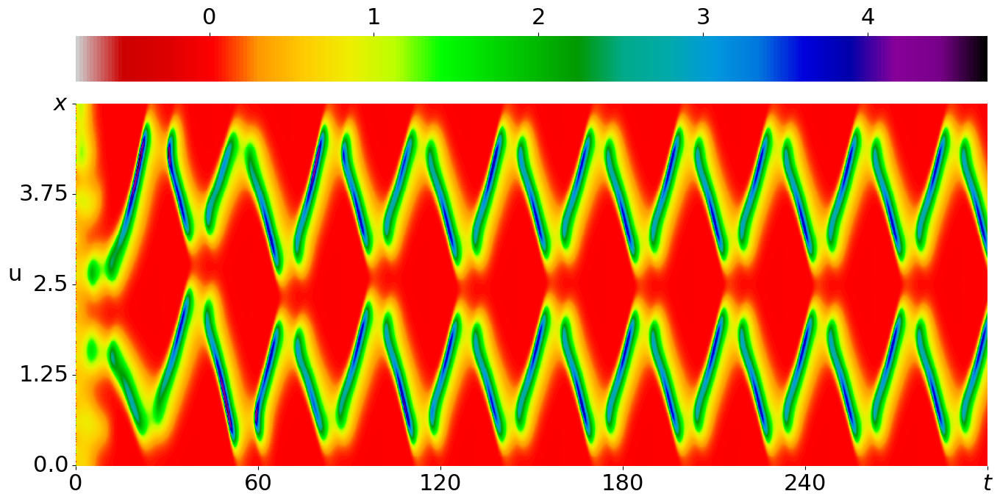

41


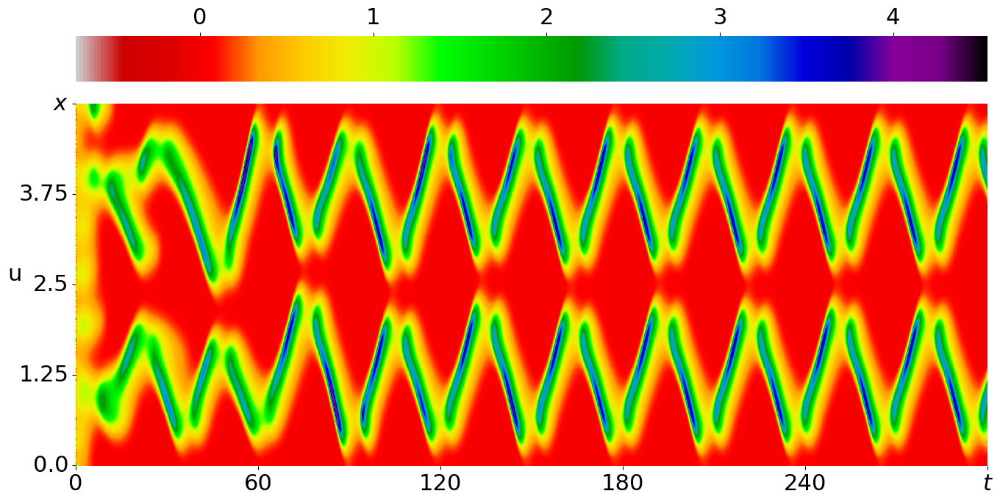

42


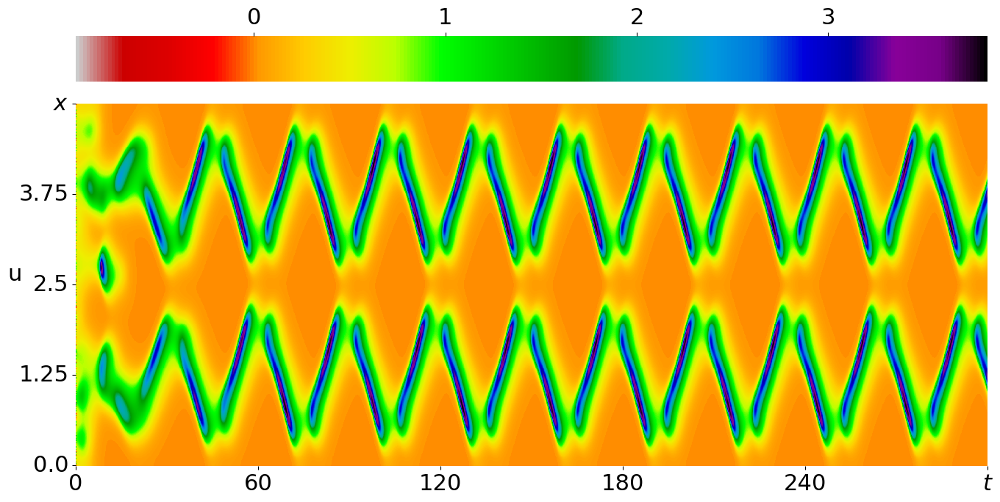

43


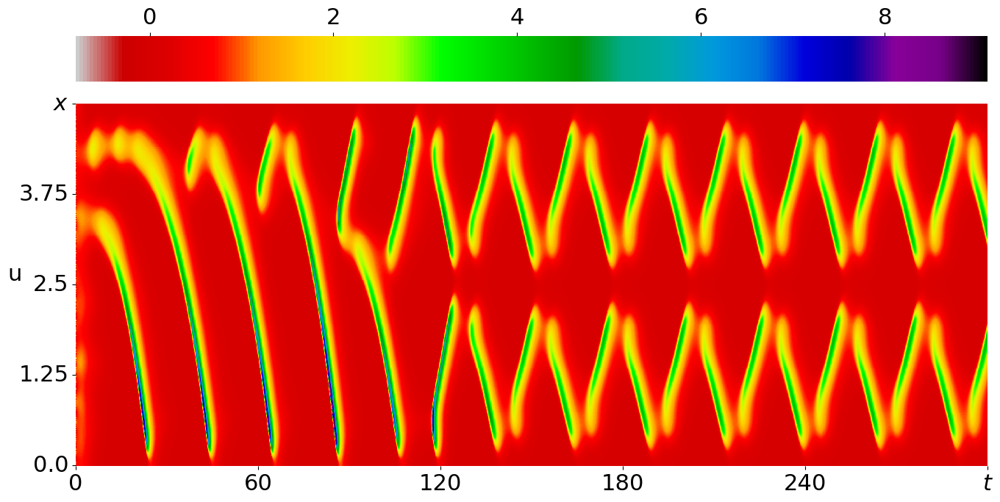

44


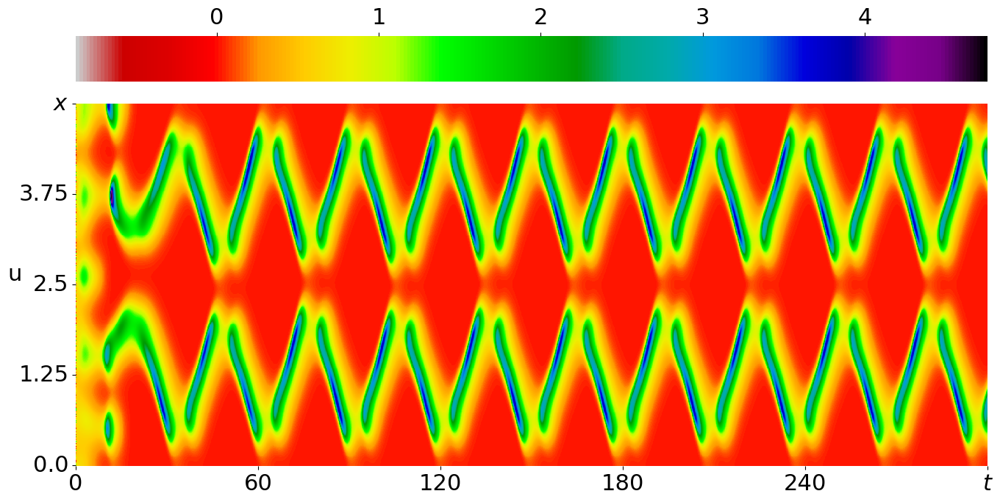

45


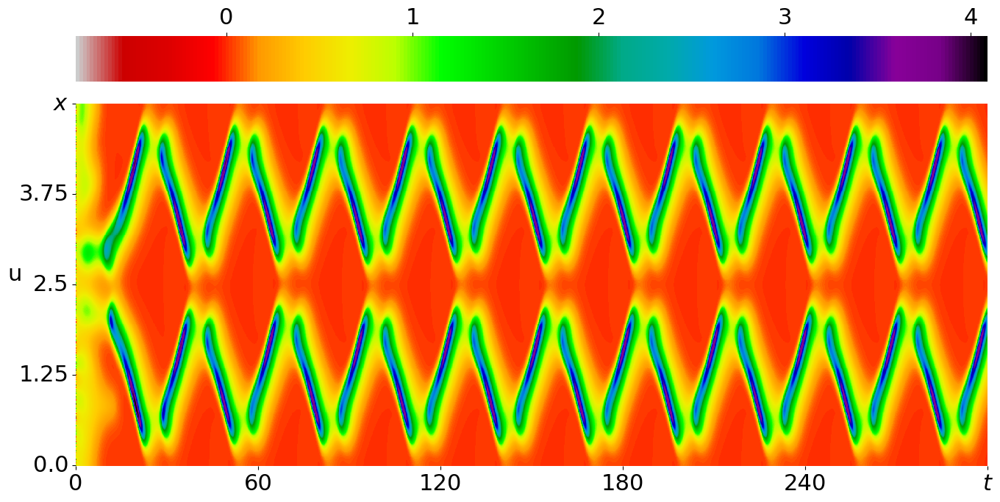

46


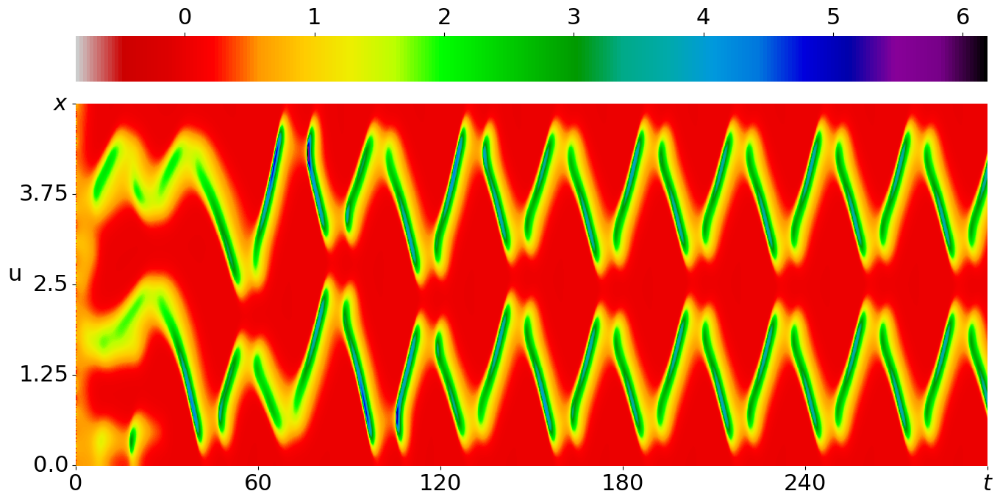

47


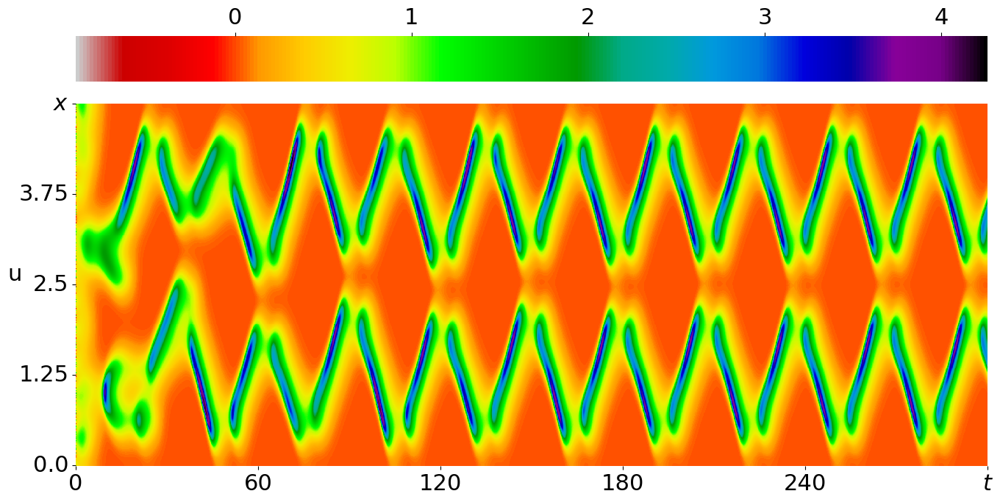

48


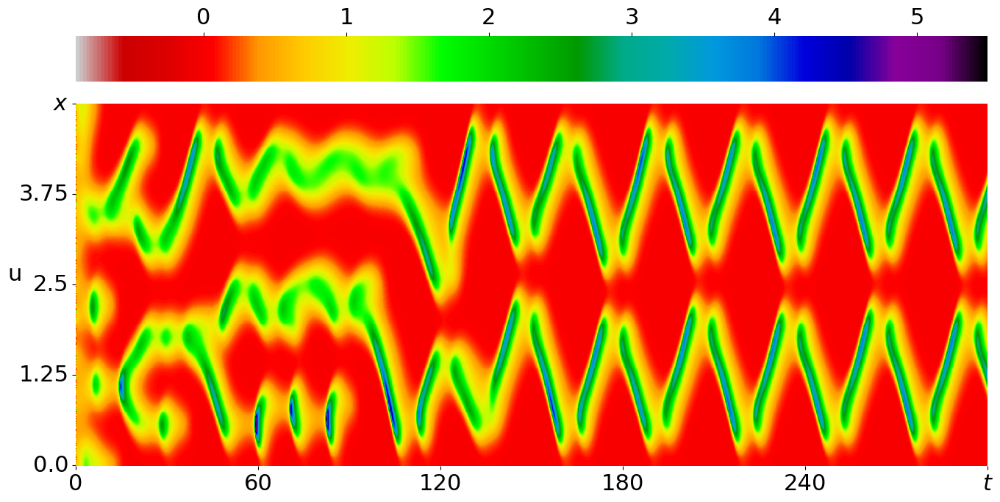

49


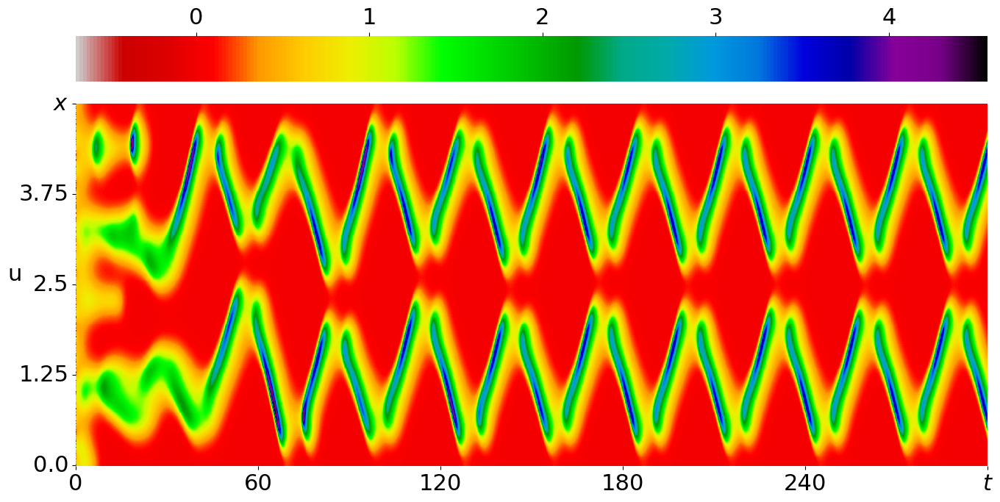

50


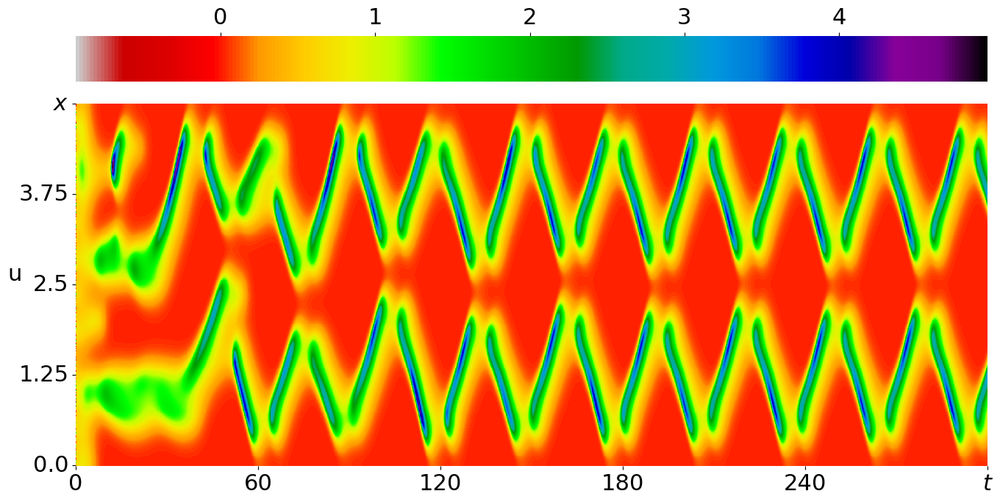

51


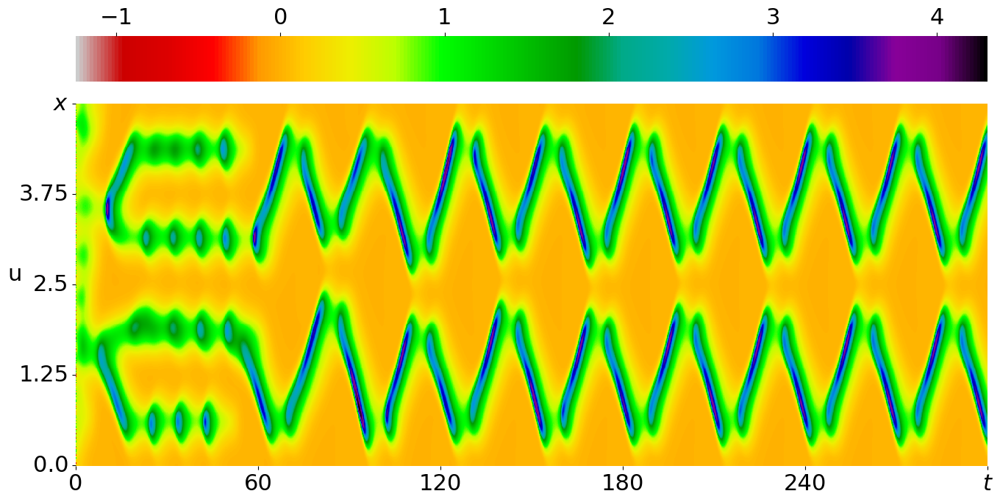

52


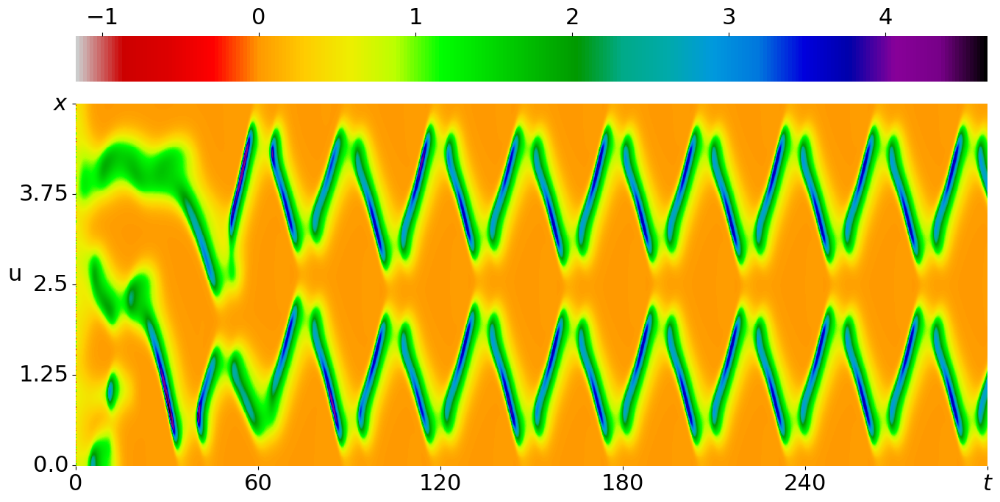

53


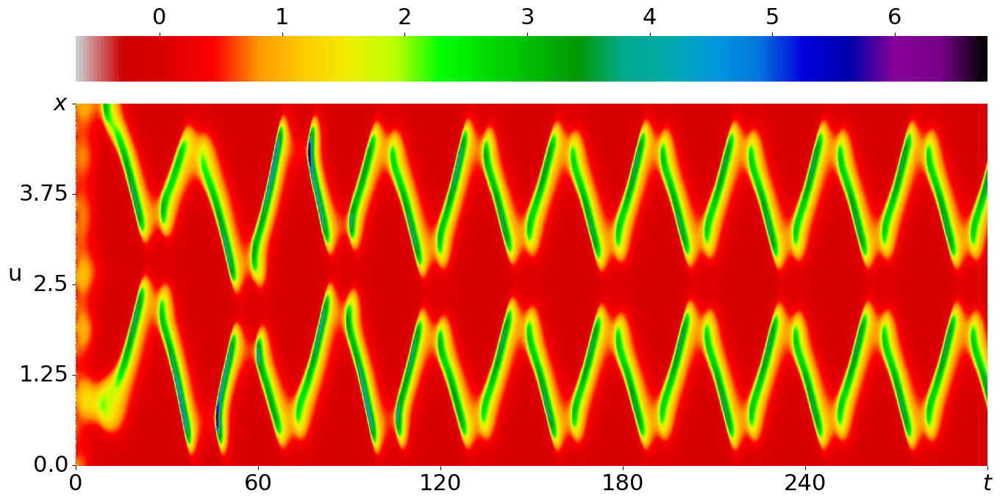

54


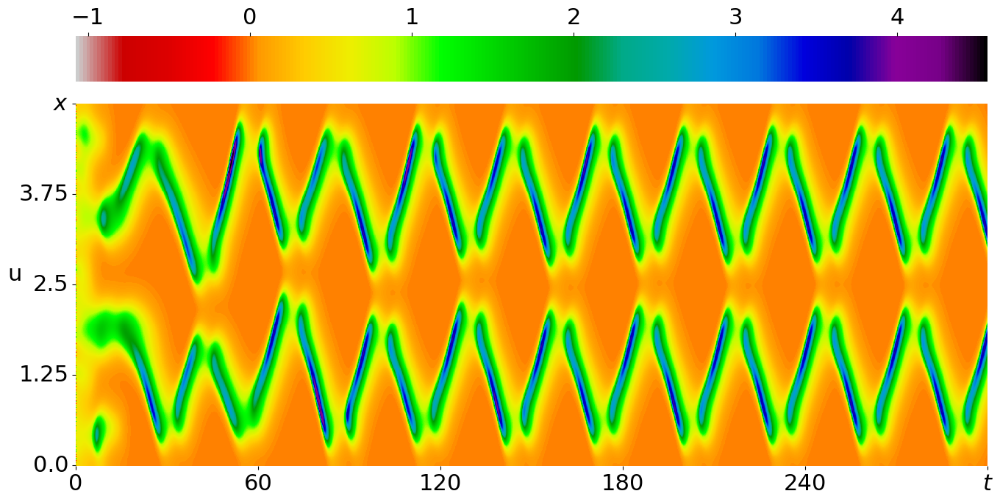

55


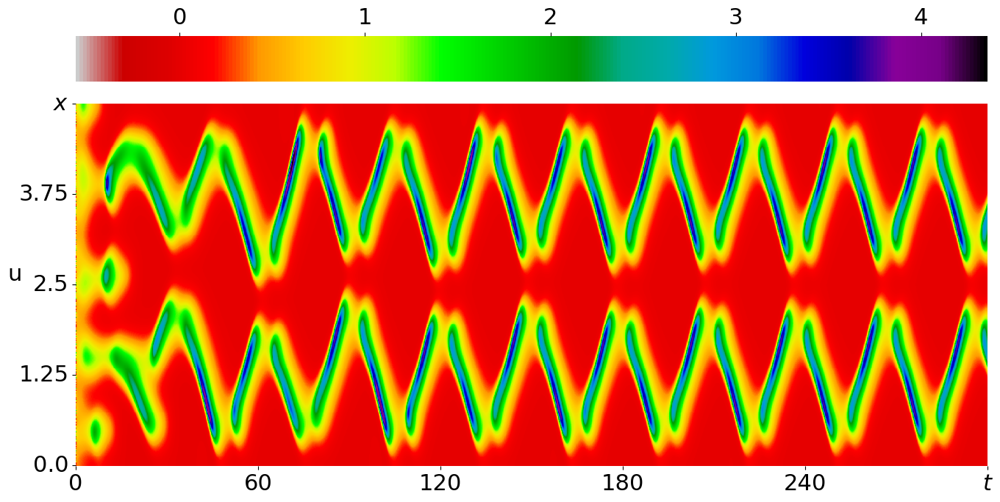

56


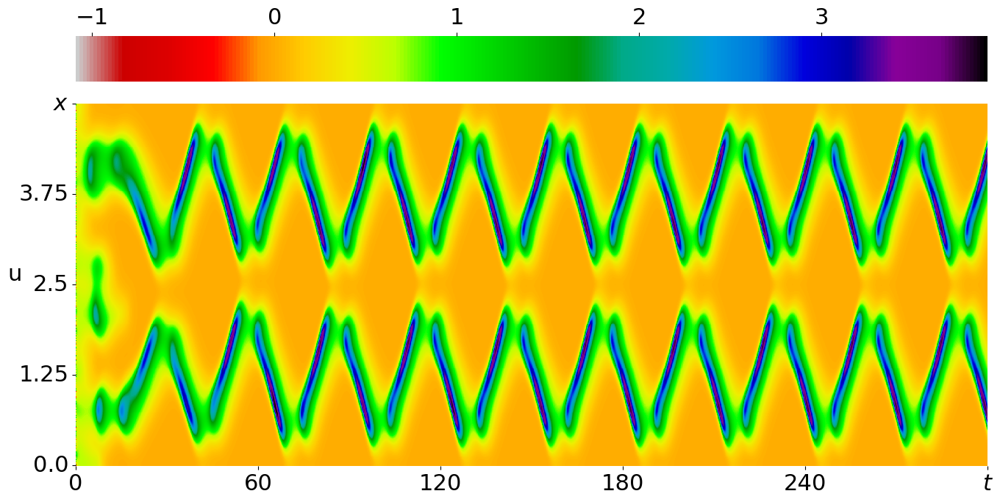

57


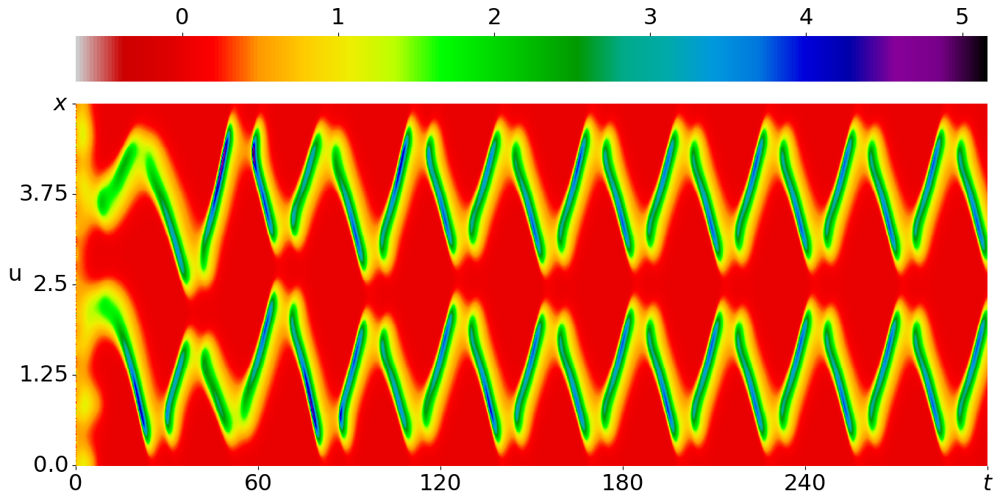

58


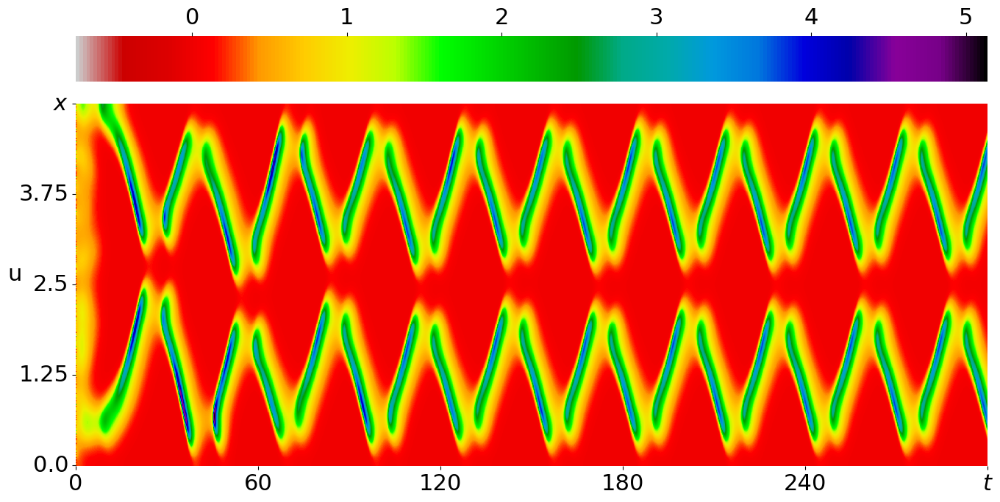

59


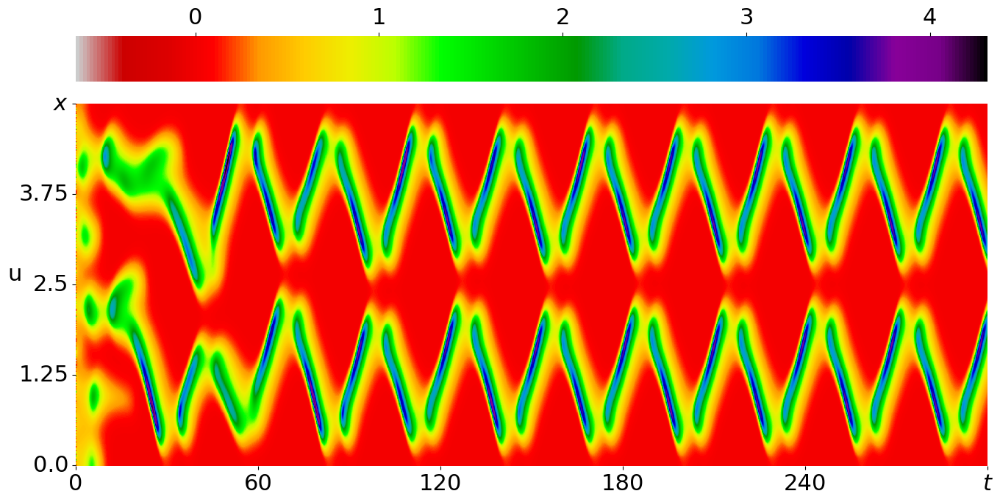

60


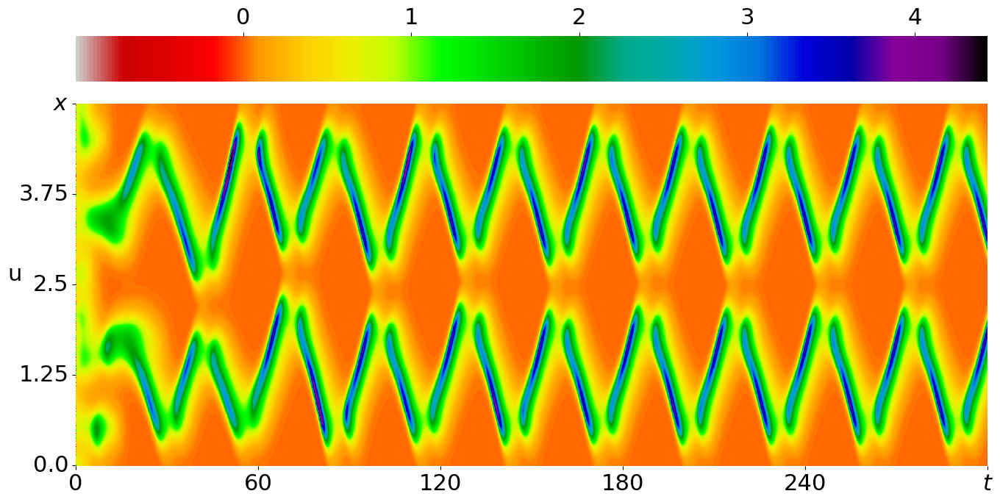

61


KeyboardInterrupt: 

In [64]:
for i, w in enumerate(waves):
    print(i)
    draw_transient(Experiment().fill_from(w.path_to_file, load_timelines=True), 'u', right_border=300)
    plt.show()

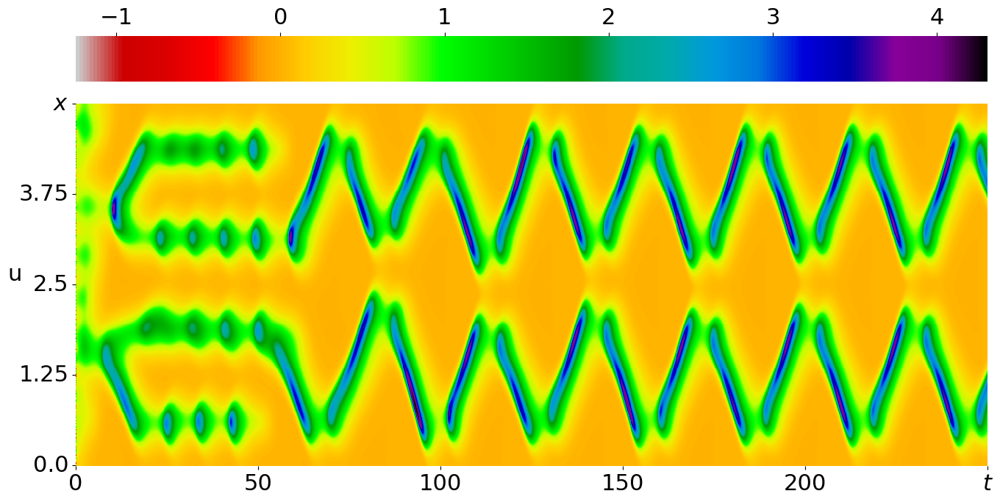

Bad /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/0_192


<AxesSubplot:ylabel='u'>

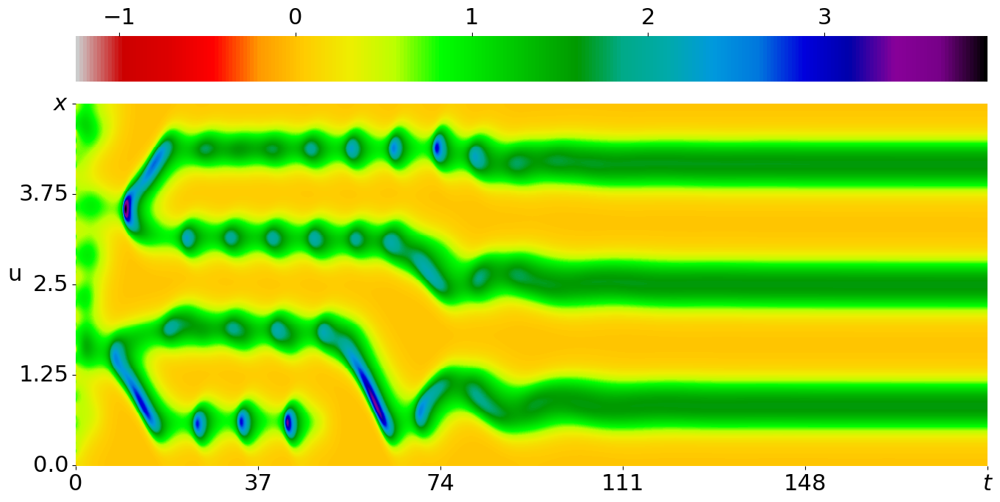

In [24]:
draw_transient(exp:=Experiment().fill_from(waves[51].path_to_file, load_timelines=True),'u', right_border=250)
plt.show()
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme)
draw_transient(wat1[1], 'u', right_border=250)

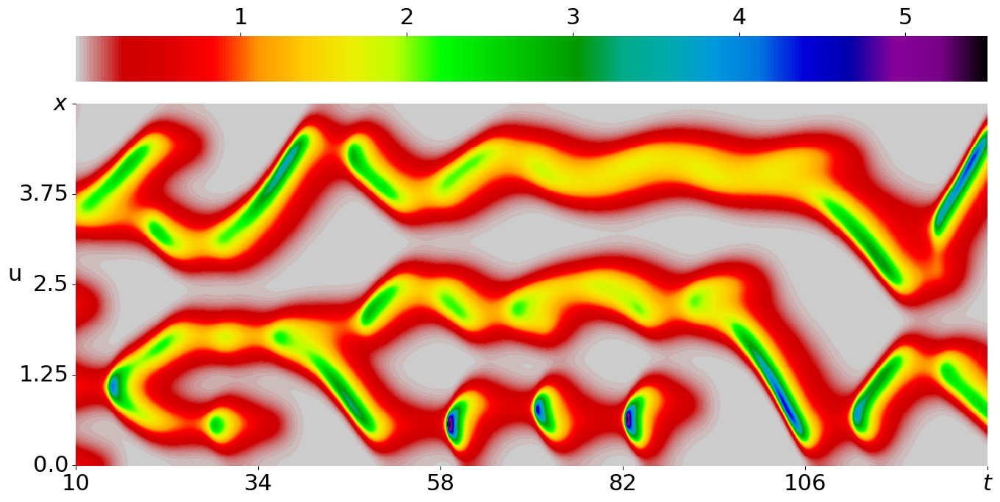

<AxesSubplot:ylabel='u'>

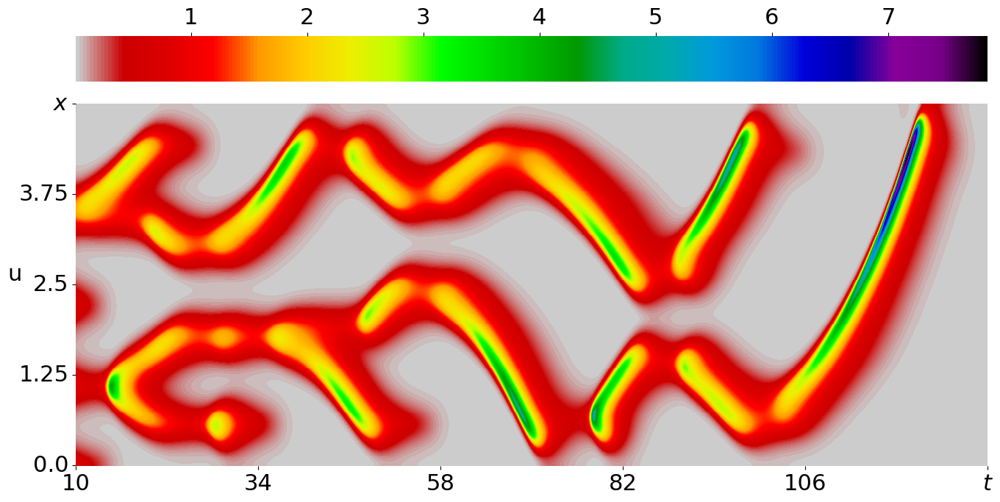

In [32]:
draw_transient(exp:=Experiment().fill_from(waves[48].path_to_file, load_timelines=True),'u', left_border=10, right_border=130)
plt.show()
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme)
draw_transient(wat1[1], 'u',left_border=10, right_border=130)

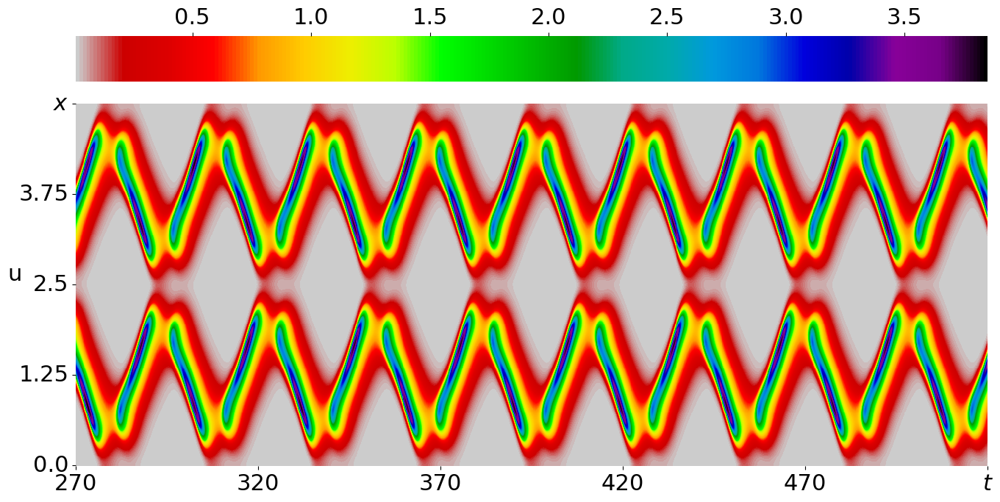

2700


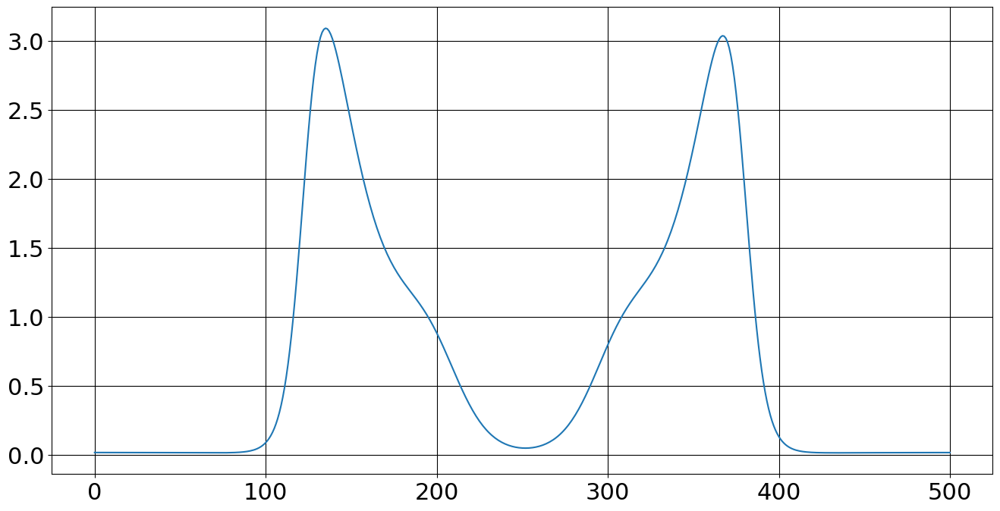

Bad /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/0_17


<AxesSubplot:ylabel='u'>

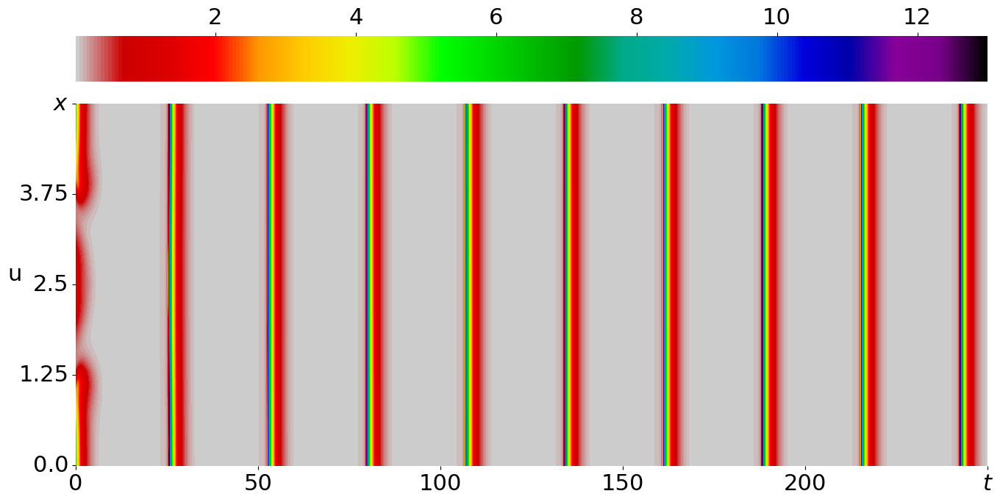

In [36]:
# тут всё было похачено для старта репро с установившегося колебательного режима при t=270 
draw_transient(exp:=Experiment().fill_from(waves[48].path_to_file, load_timelines=True),'u', left_border=270, right_border=520)
plt.show()
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme)
draw_transient(wat1[1], 'u',right_border=250)

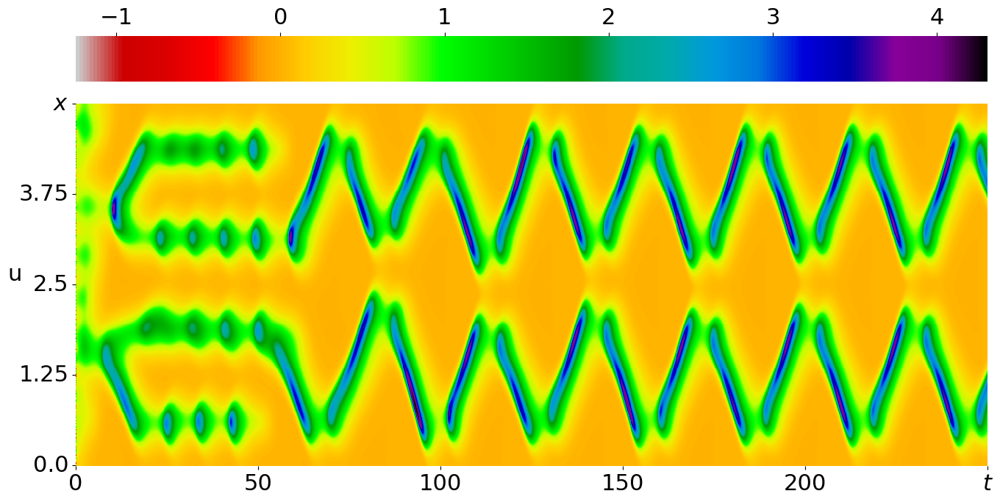

Good /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/0_192


<AxesSubplot:ylabel='u'>

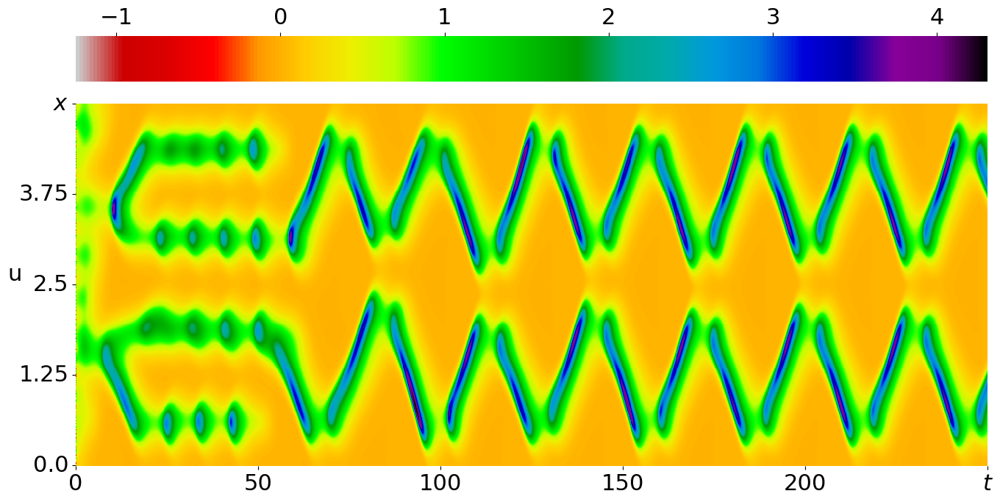

In [30]:
draw_transient(exp:=Experiment().fill_from(waves[51].path_to_file, load_timelines=True),'u', right_border=250)
plt.show()
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme)
draw_transient(wat1[1], 'u', right_border=250)

Bad /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/0_192


<AxesSubplot:ylabel='u'>

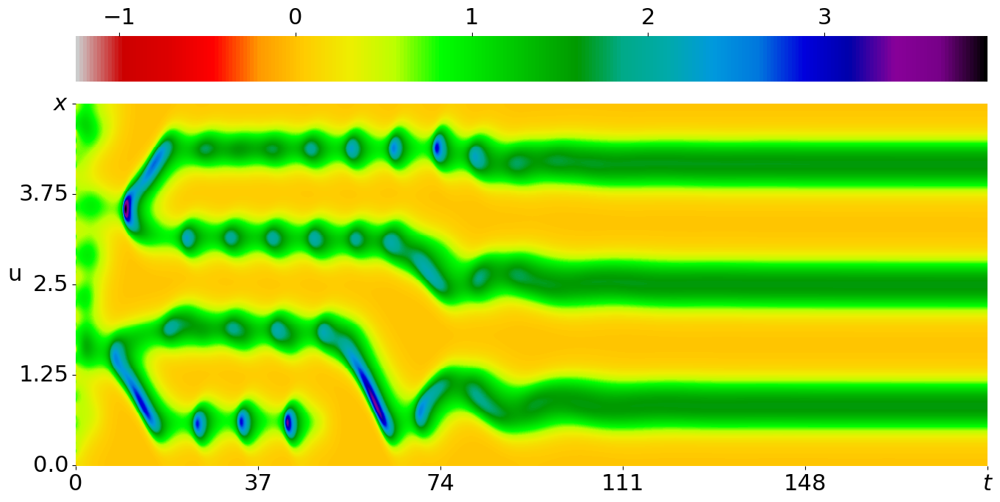

In [29]:
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme)
draw_transient(wat1[1], 'u', right_border=250)

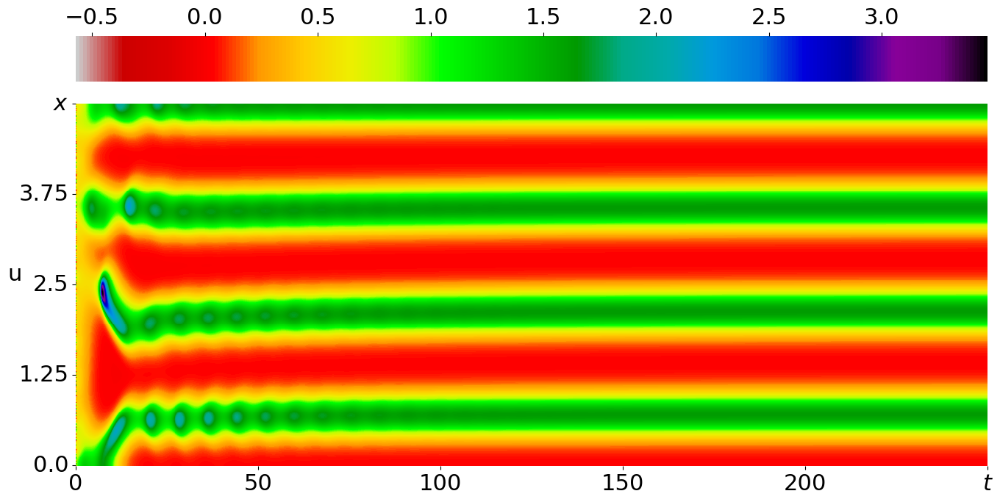

Good /media/alexander/BigDisk/data/fst_selk_strogg_2023_01_22_range_5/0_1


<AxesSubplot:ylabel='u'>

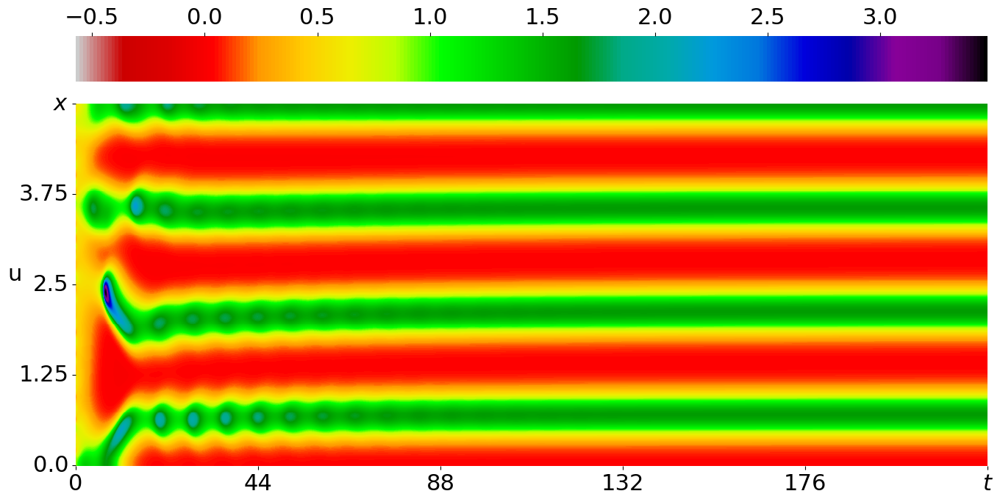

In [37]:


draw_transient(exp:=Experiment().fill_from(params_to_exps[(0.0025, 0.6)][1].path_to_file, load_timelines=True),'u', right_border=250)
plt.show()
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme, t_max=250)
draw_transient(wat1[1], 'u', right_border=250)

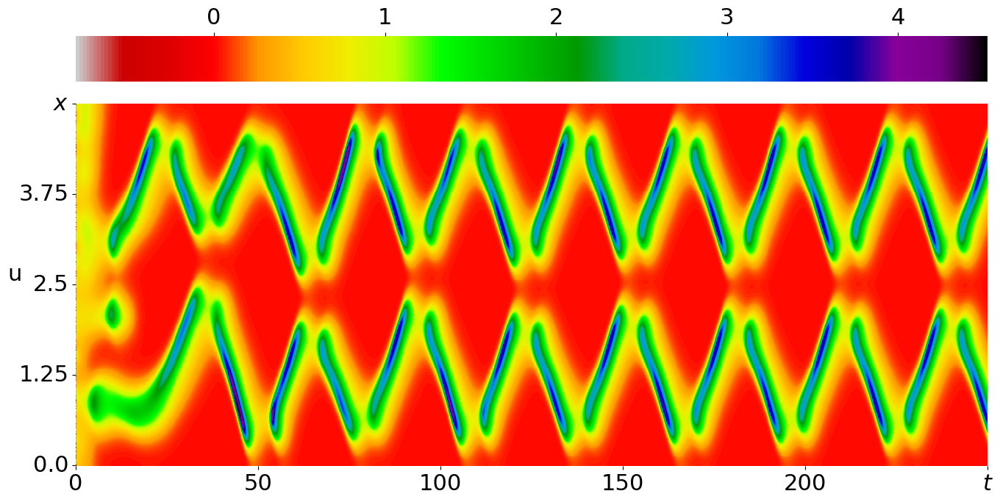

{'a': 0.0025, 'b': 0.6, 'Dx': 0.01, 'Dy': 0.1, 'model': 'Selkov-Strogatz'}

In [94]:
draw_transient(exp:=Experiment().fill_from(params_to_exps[(0.0025, 0.6)][106].path_to_file, load_timelines=True),'u', right_border=250)
plt.show()
exp.model_config

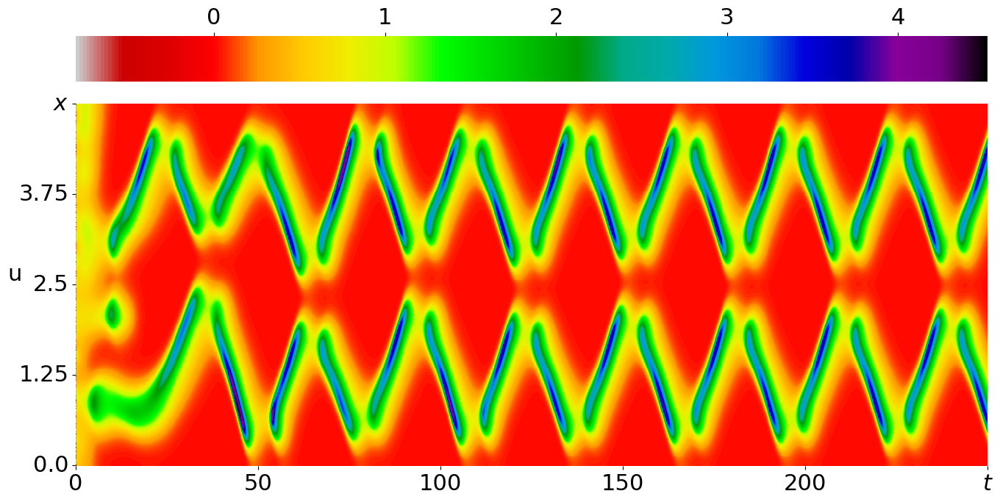

{'dx': 0.01, 'dt': 0.001, 't_max': 1000, 'min_t': None, 'save_timeline': True, 'timeline_save_step_delta': 100, 'noise_amp': 0, 'seed': None, 'x_right': 5, 'x_left': 0, 'method': 'tdma_implicit'}
{'dx': 0.01, 'dt': 5e-05, 't_max': 250, 'min_t': None, 'save_timeline': True, 'timeline_save_step_delta': 100, 'noise_amp': 0, 'seed': None, 'x_right': 5, 'x_left': 0, 'method': 'tdma_implicit'}


<AxesSubplot:ylabel='u'>

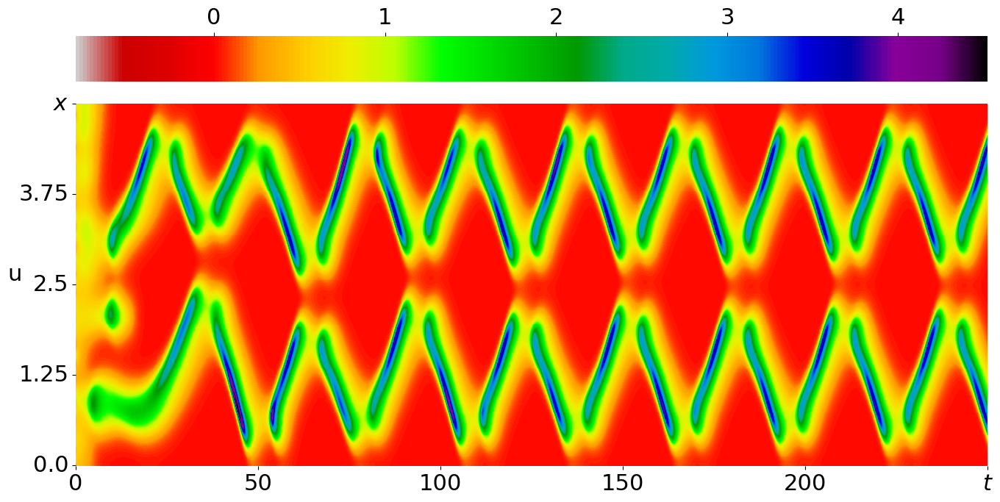

In [47]:
draw_transient(exp:=Experiment().fill_from(params_to_exps[(0.0025, 0.6)][106].path_to_file, load_timelines=True),'u', right_border=250)
plt.show()
wat1 = check_robustness(exp.path_to_file, SelkovStrogatz1DConfiguration, TdmaParameters1D, integrate_tdma_implicit_scheme, t_max=250, dt_div=20)
draw_transient(wat1[1], 'u', right_border=250)

In [51]:
wat1[1].timelines['u'].shape,  exp.timelines['u'].shape

((50001, 501), (10001, 501))

In [1]:
res_exps[2.0]

NameError: name 'res_exps' is not defined